# Anime Analysis and Recommendation

Rachael Bryant

Flatiron Capstone

Presented on

## Summary

Classifying the synopses of animes as according to the MyAnimeList dataset according to the score of the anime was the primary directive of this project. This dataset was chosen from Kaggle, scrapped in 2022 and contained descriptive attributes of the anime (type, genre, themes, source, duration, score, and rank, etc.). While exploring the data, it was discovered that comedy was the most depicted genre, TV was the most depicted type, and Toei animation is the most prolific studio. However, there was not a high correlation between these fatures according to the correlation matrix heatmap. In order to compare the highly scored anime with the highest grossing movies, the Box Office Mojo site was scrapped using Beautiful Soup and explored. While preparing the data for modeling through dropping 'Unknown' in rows and rounding the scores, NLK (Natural Language Toolkit) was utilized in tokenizing, lemmatization, and navigating stop words in the text. After conducting a train-test split on the data in order to properly validate the models, the data was standardized using StandardScaler and then vectorized using CountVectorizer. FreqDist from the NLK package aided in displaying the most frequent words that appear throughout the tweets (source, one, one, write, mal). Basic Logistic Regression, Support Vector Machines, Stochastic Gradient Descent, Random Forest, Naive Nayes, and K-nearest Neighbors models were tested first. Although the highest recall recorded was only .50, hypertuning was performed on Random Forest. Unsupervised K-Means was also performed, as well as word2vec models. 

## Overview

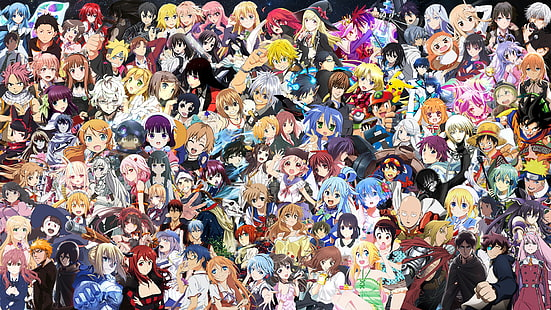

This project analyses the text of the description of the anime in order to predict the score of an anime in a multiclass classification problem and then a recommendation program is created to provide the best recommendation.

## Business Problem

<img src="Images/MyAnimeList.png" width=200 height=100>

My Anime List want to know the best predictors for a highly ranked anime. Specifically whether any aspect of the description meant for marketing influences rank or rating of an anime and then to combine the data to create a more powerful recommendation program.

## Data Understanding

The primary dataset was sourced from Kaggle. It was utilized from web scraping sourced by MyAnimeList.net. 21460 total data items are contained in this dataset. In detail, this dataset contains:

-  Backgrounds, such as synopsis and background.
-  Title and alternative titles, such as title, synonyms, Japanese, and English.
-  Detailed information, such as genres, themes, demographics, and status.
-  Statistics, such as score, rank, and popularity.

In [1]:
#import necessary libraries
# !conda update -n base -c conda-forge conda
import pandas as pd 
# !pip install tabulate
import numpy as np 
# !pip install wordcloud
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import sklearn
from sklearn.tree import DecisionTreeClassifier 
from sklearn.metrics import accuracy_score, roc_curve, auc
from sklearn import tree 
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, recall_score,precision_score,f1_score,log_loss
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_auc_score
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.neighbors import KNeighborsClassifier
from sklearn.datasets import make_multilabel_classification
import warnings; warnings.filterwarnings('ignore')
from sklearn import metrics
from sklearn.ensemble import RandomForestRegressor
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import LinearSVC
from sklearn.model_selection import RandomizedSearchCV
!pip install tabulate
from tabulate import tabulate
!pip install dataframe-image
import dataframe_image as dfi
from pandas.plotting import table 
#!conda install -c conda-forge imbalanced-learn
!pip install imblearn
import imblearn
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE
!pip install wordcloud
import wordcloud
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import HashingVectorizer
from sklearn.naive_bayes import MultinomialNB
from nltk import FreqDist
from nltk.tokenize import word_tokenize
from nltk import pos_tag
from nltk.stem import PorterStemmer
import re
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import nltk
import string 
from nltk.tokenize import RegexpTokenizer
from collections import defaultdict
from nltk.corpus import wordnet 
from matplotlib.ticker import MaxNLocator
from sklearn.pipeline import Pipeline
from collections import Counter
from imblearn.combine import SMOTEENN, SMOTETomek
from imblearn.pipeline import make_pipeline
from sklearn.svm import LinearSVC
from sklearn import *
from sklearn.metrics import roc_auc_score
!pip install scikit-plot
from scikitplot.metrics import plot_roc_curve
# from sklearn.metrics import plot_roc_curve
from sklearn.calibration import CalibratedClassifierCV
import pandas as pd
import dataframe_image as dfi
from importlib.metadata import version
from sklearn.model_selection import cross_val_predict
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import plotly
import plotly.graph_objects as go
import plotly.offline as pyo
from plotly.offline import init_notebook_mode
from sklearn.cluster import SpectralClustering
import plotly.offline as pyoff
import plotly.graph_objs as go
from sklearn.pipeline import make_pipeline
from sklearn.pipeline import make_pipeline
import plotly.express as px
# !conda update -n base -c defaults conda
import nltk
nltk.download('stopwords')
from sklearn.datasets import make_multilabel_classification

!pip install lxml

from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)

!pip import surprise
import requests
from bs4 import BeautifulSoup

from sklearn.datasets import load_digits
from sklearn.decomposition import PCA

!pip install scikit-surprise
from surprise import Reader
import surprise
import os
import pandas as pd
import numpy as np
from scipy.stats import randint
import seaborn as sns # used for plot interactive graph.
import matplotlib.pyplot as plt
import seaborn as sns
from io import StringIO
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import chi2
from IPython.display import display
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from scipy.sparse import csc_matrix
from scipy.sparse.linalg import svds
import operator as op
from surprise.model_selection import train_test_split
from surprise.model_selection import GridSearchCV
from surprise.model_selection import cross_validate
from surprise.prediction_algorithms import KNNWithMeans, KNNBasic, KNNBaseline
from surprise.prediction_algorithms import knns
from surprise.prediction_algorithms import SVD
from surprise.similarities import cosine, msd, pearson
from surprise import accuracy
from surprise import Reader
from surprise import Dataset
nltk.download('wordnet')

!pip install scikit-multilearn
from skmultilearn.model_selection import iterative_train_test_split

import nltk
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')

from sklearn.naive_bayes import GaussianNB,MultinomialNB
from sklearn.metrics import accuracy_score,hamming_loss
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
!pip install scikit-multilearn
from skmultilearn.problem_transform import BinaryRelevance
from skmultilearn.problem_transform import ClassifierChain
from skmultilearn.problem_transform import LabelPowerset

# !pip install sklearn.utils
# import sklearn.utils.parallel
!pip install autoviml
# from imbalanced_ensemble.ensemble import SelfPacedEnsembleClassifier, RUSBoostClassifier
# from autoviml.Auto_ViML import Auto_ViML

import io
import re
import string
import tqdm
!pip install tensorflow
import tensorflow as tf
from tensorflow.keras import layers

!pip install gensim
import gensim
from gensim.models import Word2Vec
from gensim import models

from sklearn.cluster import KMeans

!pip install python-utils 
import python_utils 

!pip install utils
import utils

#to record how long this notebook takes to run
import time
a = time.time()

Matplotlib is building the font cache; this may take a moment.


Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 30.3 MB/s eta 0:00:0000:0100:01


Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 226.0/226.0 kB 12.4 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 458.9/458.9 kB 17.4 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com


[nltk_data] Downloading package stopwords to
[nltk_data]     /home/ec2-user/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 37.4 MB/s eta 0:00:0000:0100:01


ERROR: unknown command "import"
Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 772.0/772.0 kB 16.6 MB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
  Created wheel for scikit-surprise: filename=scikit_surprise-1.1.3-cp310-cp310-linux_x86_64.whl size=1178896 sha256=41256dcfad6fa306e1daf4d0f88d68d0c17ca82bcf6ee99fbea50e9cca83c51c
  Stored in directory: /home/ec2-user/.cache/pip/wheels/df/e4/a6/7ad72453dd693f420b0c639bedeec34641738d11b55d8d9b84
Successfully built scikit-surprise


[nltk_data] Downloading package wordnet to /home/ec2-user/nltk_data...


Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.4/89.4 kB 3.0 MB/s eta 0:00:00


[nltk_data] Downloading package punkt to /home/ec2-user/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/ec2-user/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.3/133.3 kB 2.5 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.5/96.5 kB 13.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 240.9/240.9 kB 25.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.6/76.6 MB 5.5 MB/s eta 0:00:00:00:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 13.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.6/193.6 MB 4.7 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 746.5/746.5 kB 7.8 MB/s eta 0:00:0000:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 636.8/636.8 kB 57.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 kB 12.1 MB/s eta 0:00:00


  Created wheel for emoji: filename=emoji-2.2.0-py3-none-any.whl size=234912 sha256=1d7b7fcd5d8a663e1e79aa3d496ad1faf7ae965ae7bdec6a71c8b8e03bc5be13
  Stored in directory: /home/ec2-user/.cache/pip/wheels/80/20/48/a9171ff16fe85966efc66492a9aed0acabb17e96c35f696dbf
Successfully built emoji
Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 588.3/588.3 MB 1.3 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.0/6.0 MB 25.3 MB/s eta 0:00:00:00:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 439.2/439.2 kB 25.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 9.4 MB/s eta 0:00:00:00:01:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 9.4 MB/s eta 0:00:00:00:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 15.4 MB/s eta 0:00:00:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.5/65.5 kB 331.3 kB/s eta 0:00:00a 0:00:01
     ━━━

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 151.7/151.7 kB 1.0 MB/s eta 0:00:00a 0:00:01
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3


2023-03-03 01:29:26.073690: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.1/24.1 MB 16.7 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.1/67.1 kB 11.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Created wheel for fst-pso: filename=fst_pso-1.8.1-py3-none-any.whl size=20430 sha256=33e1981315278ef200bf69660cc7c73e154c1a08be98ba5c28a5c6e79ab6af42
  Stored in directory: /home/ec2-user/.cache/pip/wheels/01/02/ee/df0699282986903a384b69aab4413af9efd26b3612b5dccc9e
  Created wheel for miniful: filename=miniful-0.0.6-py3-none-any.whl size=3513 sha256=f15c5df35314cde5060f9ae75ae6081653650d04f2253986792b45db376ab9ee
  Stored in directory: /home/ec2-user/.cache/pip/wheels/43/aa/48/5c66b931ff013ad19774081aa19656637af5c0cc33b5494b30
Successfully built fst-pso miniful
Looking in i

### Primary Dataset: MyAnimeList EDA

The MyAnimeList csv is loaded below using pandas read_csv. The null values of each category are listed to understand whether this dataset is robust enough to further analyze. Episodes, Demographics, Duration_Minutes, Score, Scored_Users, and Ranked contain null values. They would cause issues when modeling later on, so these null values are dropped from the dataset. Just to double check that these values were dropped, the null values of each category are listed again, all are 0. To make sure there are still enough values to analyze, the total number of records is listed at the end and it is suitable at 13030.

In [2]:
#load data from csv file
myanimelist = pd.read_csv('Anime_2.csv', encoding= 'unicode_escape')
print(myanimelist.isnull().sum())
myanimelist.dropna(inplace=True)
print(myanimelist.head(5))
print(myanimelist.isnull().sum())
print(f"Total number of records: {len(myanimelist)}")

ID                     0
Title                  0
Synonyms               0
Japanese               0
English                0
Synopsis               0
Type                   0
Episodes             547
Status                 0
Start_Aired            0
End_Aired              0
Premiered              0
Broadcast              0
Producers              0
Licensors              0
Studios                0
Source                 0
Genres                 0
Themes                 0
Demographics           0
Duration_Minutes     599
Rating                 0
Score               6898
Scored_Users        6898
Ranked              1924
Popularity             0
Members                0
Favorites              0
dtype: int64
      ID                             Title  \
0  16498                Shingeki no Kyojin   
1   1535                        Death Note   
2   5114  Fullmetal Alchemist: Brotherhood   
3  30276                     One Punch Man   
4  11757                  Sword Art Online   

          

The entire dataset is better described below in a table which describes the count, unique values, frequency and other descriptors of each column. It is important to note the 'Unknown' values that may cause issue in future analyzing. 

In [3]:
myanimelist.describe(include = 'all')


,ID,Title,Synonyms,Japanese,English,Synopsis,Type,Episodes,Status,Start_Aired,...,Themes,Demographics,Duration_Minutes,Rating,Score,Scored_Users,Ranked,Popularity,Members,Favorites
count,13030.000000,13030,13030,13030,13030,13030,13030,13030.000000,13030,13030,...,13030,13030,13030.000000,13030,13030.000000,13030.000000,13030.000000,13030.000000,1.303000e+04,13030.000000
unique,NaN,13030,8188,12332,6693,12588,7,NaN,2,6315,...,685,10,NaN,6,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,Shingeki no Kyojin,Unknown,Unknown,Unknown,Unknown,TV,NaN,Finished Airing,2008,...,Unknown,Unknown,NaN,PG-13 - Teens 13 or older,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,1,4607,23,6215,269,4237,NaN,12960,30,...,4560,8677,NaN,6409,NaN,NaN,NaN,NaN,NaN,NaN
mean,20980.652187,NaN,NaN,NaN,NaN,NaN,NaN,12.590560,NaN,NaN,...,NaN,NaN,25.967229,NaN,6.459653,29206.640215,65573.693016,7587.679739,6.283918e+04,736.706216
std,16081.671520,NaN,NaN,NaN,NaN,NaN,NaN,52.390039,NaN,NaN,...,NaN,NaN,26.263119,NaN,0.924109,89361.263385,37873.954911,4740.249477,1.963611e+05,5423.097698
min,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,...,NaN,NaN,1.000000,NaN,1.841000,101.000000,12.000000,1.000000,1.720000e+02,0.000000
25%,4760.250000,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,...,NaN,NaN,6.000000,NaN,5.831000,377.000000,32784.500000,3361.500000,1.126250e+03,1.000000
50%,19646.000000,NaN,NaN,NaN,NaN,NaN,NaN,2.000000,NaN,NaN,...,NaN,NaN,23.000000,NaN,6.471000,1942.000000,65547.000000,7415.000000,5.224000e+03,7.000000
75%,35978.750000,NaN,NaN,NaN,NaN,NaN,NaN,12.000000,NaN,NaN,...,NaN,NaN,26.000000,NaN,7.141000,14279.250000,98379.500000,11597.750000,3.397125e+04,70.000000


In [4]:
myanimelist.head()

,ID,Title,Synonyms,Japanese,English,Synopsis,Type,Episodes,Status,Start_Aired,...,Themes,Demographics,Duration_Minutes,Rating,Score,Scored_Users,Ranked,Popularity,Members,Favorites
0,16498,Shingeki no Kyojin,"AoT, SnK",é²æã®å·¨äºº,Attack on Titan,"Centuries ago, mankind was slaughtered to near...",TV,25.0,Finished Airing,"Apr 7, 2013",...,"Gore, Military, Survival",Shounen,24.0,R - 17+ (violence & profanity),8.531,519803.0,1002.0,1,3524109,155695
1,1535,Death Note,DN,ãã¹ãã¼ã,Death Note,"Brutal murders, petty thefts, and senseless vi...",TV,37.0,Finished Airing,"Oct 4, 2006",...,Psychological,Shounen,23.0,R - 17+ (violence & profanity),8.621,485487.0,732.0,2,3504535,159701
2,5114,Fullmetal Alchemist: Brotherhood,"Hagane no Renkinjutsushi Fullmetal Alchemist, ...",é¼ã®é¬éè¡å¸« FULLMETAL ALCHEMIST,Fullmetal Alchemist Brotherhood,After a horrific alchemy experiment goes wrong...,TV,64.0,Finished Airing,"Apr 5, 2009",...,Military,Shounen,24.0,R - 17+ (violence & profanity),9.131,900398.0,12.0,3,2978455,207772
3,30276,One Punch Man,"One Punch-Man, One-Punch Man, OPM",ã¯ã³ãã³ãã³,One Punch Man,The seemingly unimpressive Saitama has a rathe...,TV,12.0,Finished Airing,"Oct 5, 2015",...,"Parody, Super Power",Seinen,24.0,R - 17+ (violence & profanity),8.511,19066.0,1112.0,4,2879907,59651
4,11757,Sword Art Online,"S.A.O, SAO",ã½ã¼ãã¢ã¼ãã»ãªã³ã©ã¤ã³,Sword Art Online,Ever since the release of the innovative Nerve...,TV,25.0,Finished Airing,"Jul 8, 2012",...,"Love Polygon, Video Game",Unknown,23.0,PG-13 - Teens 13 or older,7.201,990254.0,29562.0,5,2813565,64997


In order to better understand the data when plotting and analyzing, the names of the columns of interest are changed. I added 'MAL' to the beginning of a few to differentiate from another dataset.

In [5]:
myanimelist = myanimelist.rename({'Title': 'MAL_Title','Themes': 'MAL_Themes', 'Genres': 'MAL_Genres', 'Score': 'MAL_Score', 'Rating': 'MAL_Rating', 'Members': 'MAL_Members', 'Popularity': 'MAL_Popularity'}, axis = 1, inplace = False)
myanimelist.columns

Index(['ID', 'MAL_Title', 'Synonyms', 'Japanese', 'English', 'Synopsis',
       'Type', 'Episodes', 'Status', 'Start_Aired', 'End_Aired', 'Premiered',
       'Broadcast', 'Producers', 'Licensors', 'Studios', 'Source',
       'MAL_Genres', 'MAL_Themes', 'Demographics', 'Duration_Minutes',
       'MAL_Rating', 'MAL_Score', 'Scored_Users', 'Ranked', 'MAL_Popularity',
       'MAL_Members', 'Favorites'],
      dtype='object')

13030 unique titles are in this data. That's enough to do substantial EDA and analysis. 

### EDA Type of anime in MyAnimeList

This section will explore this dataset to better understand the patterns in the type of anime.
There are 7 types of anime: 

-  TV
- Movie
- Special
- OVA : 'original video animation', anime films and series meant for home video release, not created for TV or theater.
- ONA : 'original net animation', anime films and series released directly to the internet, not created for TV or theater.
- Music : short, few minute anime created for musical release
- Unknown (only 1 value)



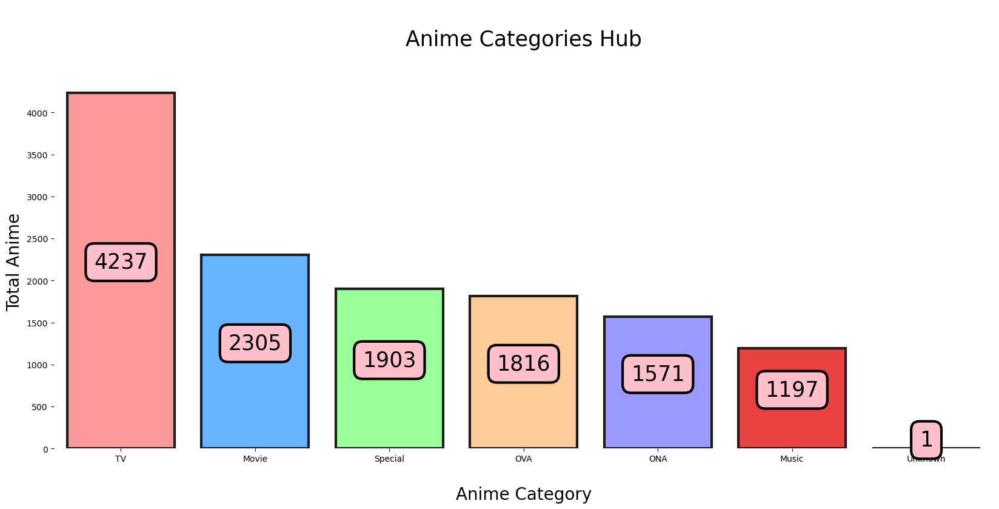

In [6]:
#visualization of how many values are in each type of anime

plt.subplots(figsize = (20,8))
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
p = sns.countplot(x = myanimelist["Type"], order = myanimelist["Type"].value_counts().index, palette = palette, saturation = 1,  edgecolor = "#1c1c1c", linewidth = 3)
p.axes.set_title("\nAnime Categories Hub\n" ,fontsize = 25)
plt.ylabel("Total Anime" ,fontsize = 20)
plt.xlabel("\nAnime Category" ,fontsize = 20)
plt.xticks(rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type = "center",padding = 10,size = 25, color = "black", rotation = 0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "pink", "edgecolor": "black", "linewidth": 3, "alpha":1})
sns.despine(left = True, bottom = True)
plt.show()

Plotly express is utilizied to depict the percentages of the types of anime below as an additional form of understanidng this data in the form of a pie chart. 

In [7]:
#creating a pie chart of anime type
type_list = list(myanimelist["Type"].unique())

type_values = []

for i in range(len(myanimelist["Type"].unique())) :

    type_values.append(myanimelist["Type"].value_counts().iloc[i])
    
fig = px.pie(values=type_values,
             names=myanimelist["Type"].unique(),
)

fig.update_traces(marker=dict(colors=palette),
                  hole = .3,
                  textposition='inside',
                  textinfo='percent+label'
)

fig.update_layout(
    annotations=[dict(text='Type', x=0.5, y=0.5, font_size=24, showarrow=False)],
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.90,
        xanchor="left",
        x=0.80
    ),
    font=dict(
        color = "purple"
    )
)
fig.show()

The top 10 scored anime of each type are depicted below. A few popular franchises stand out, such as Gintama, which is in the top 10 of every category but ONA. Violet Evergarden and Hunter X Hunter are also well represented. Specials are also scored lower than every other category. 

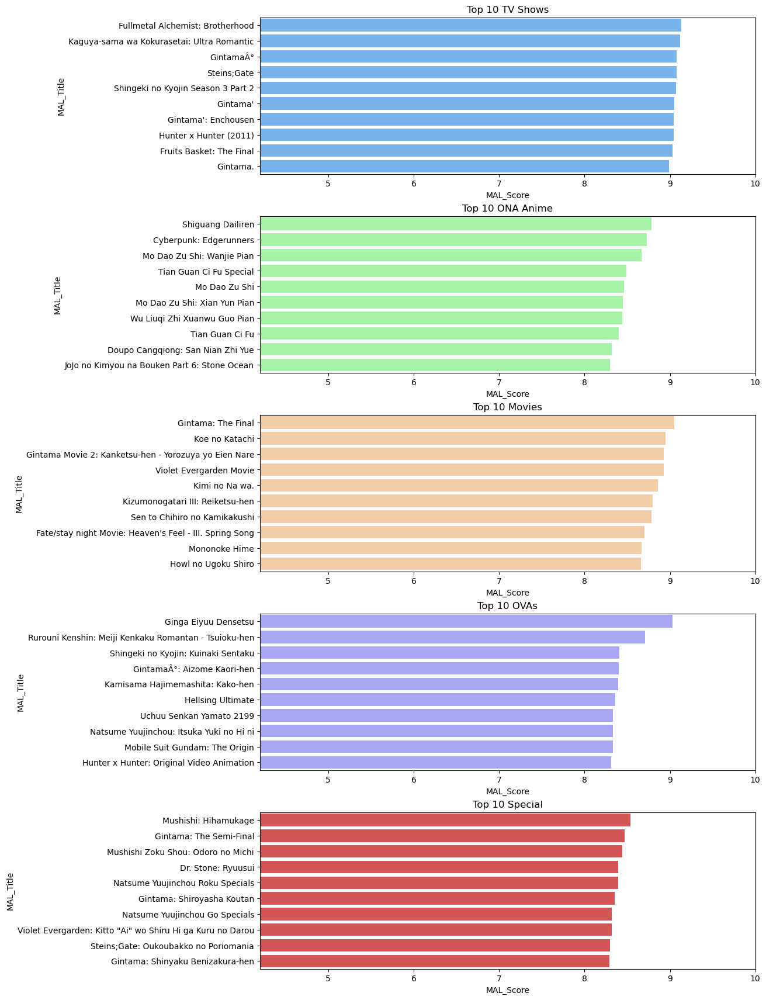

In [8]:
#visualization of the anime types as separated by type and ordered by score

tv_shows = myanimelist[myanimelist["Type"] == "TV"]
top_10_tv_shows = tv_shows.sort_values(by='MAL_Score', ascending = False).head(10)
ona_anime = myanimelist[myanimelist["Type"] == "ONA"]
top_10_ona_anime = ona_anime.sort_values(by='MAL_Score', ascending = False).head(10)
movies = myanimelist[myanimelist["Type"] == "Movie"]
top_10_movies = movies.sort_values(by='MAL_Score', ascending = False).head(10)
ova = myanimelist[myanimelist["Type"] == "OVA"]
top_10_ova = ova.sort_values(by='MAL_Score', ascending = False).head(10)
special = myanimelist[myanimelist["Type"] == "Special"]
top_10_special = special.sort_values(by='MAL_Score', ascending = False).head(10)
fig, axes = plt.subplots(5, 1, figsize=(13, 17), constrained_layout = True)

tv_plot = sns.barplot(ax=axes[0], y=top_10_tv_shows["MAL_Title"], x=top_10_tv_shows["MAL_Score"], color = palette[1])
axes[0].set_title("Top 10 TV Shows")

ona_plot = sns.barplot(ax=axes[1], y=top_10_ona_anime["MAL_Title"], x=top_10_ona_anime["MAL_Score"], color = palette[2])
axes[1].set_title("Top 10 ONA Anime")

movies_plot = sns.barplot(ax=axes[2], y=top_10_movies["MAL_Title"], x=top_10_movies["MAL_Score"], color = palette[3])
axes[2].set_title("Top 10 Movies")

ova_plot = sns.barplot(ax=axes[3], y=top_10_ova["MAL_Title"], x=top_10_ova["MAL_Score"], color = palette[4])
axes[3].set_title("Top 10 OVAs")

special_plot = sns.barplot(ax=axes[4], y=top_10_special["MAL_Title"], x=top_10_special["MAL_Score"], color = palette[5])
axes[4].set_title("Top 10 Special")

tv_plot.set(xlim=(4.2, 10)) 
ona_plot.set(xlim=(4.2, 10))
movies_plot.set(xlim=(4.2, 10))
ova_plot.set(xlim=(4.2, 10))
special_plot.set(xlim=(4.2,10))
plt.show()

The Plotly express visualization below depicted the type of anime distributed by the score and popularity. TV anime are the highest scored and most popular while music is not highly scored and not as popular. Popularity is organized in which 1 = most popular.

In [9]:
fig = px.scatter(myanimelist,
y="MAL_Score",
x='MAL_Popularity',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

The visualization below is just to show that there are a few VERY long TV anime! Next longest type of anime is ONA.

In [10]:
fig = px.scatter(myanimelist,
y="MAL_Score",
x='Episodes',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

The duration of each type of anime is depicted below along with the duration in minutes of each type. Movies are typically the longest of the types of anime, but many Specials have long durations. 

In [11]:
fig = px.scatter(myanimelist,
y="MAL_Score",
x='Duration_Minutes',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

Plotly express is utilized below to showcase the type of anime in comparison to the score and now many members that anime has. TV anime have the most members, some movies have a large member following as well, but most Music anime do not have members.

In [12]:
fig = px.scatter(myanimelist,
y="MAL_Score",
x='MAL_Members',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()


The distribution of the anime scores are shown below using plotly graph objects for visualization. Most anime are rated about 6.5 and it is a good shape of a bell curve overall.

In [13]:
data = myanimelist['MAL_Score'].value_counts().sort_index(ascending=False)
trace = go.Bar(x = data.index,
               text = ['{:.1f} %'.format(val) for val in (data.values / myanimelist.shape[0] * 100)],
               textposition = 'auto',
               textfont = dict(color = '#66b3ff'),
               y = data.values,
              )
layout = dict(title = 'Distribution Of {} Anime Scores'.format(myanimelist.shape[0]),
              xaxis = dict(title = 'Rating'),
              yaxis = dict(title = 'Count'))
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)

### EDA Studios in MyAnimeList

This section will explore this dataset to better understand the patterns in the Studio category of anime. There are 1114 anime studios in this dataset. The studio creates the animation and usually they have specific characteristics they are known for. The studio with the most anime listed is Toei animation. This could be due to it's long history as well as many populart franchises. The number of studios as well as the top 20 with the most anime in the dataset are depicted below. 



In [14]:
#number of users
print("Number of studios:", myanimelist.Studios.nunique())
print(myanimelist['Studios'].value_counts()[0:20].sort_values())
studios = myanimelist['Studios'][0:20].sort_values()
# myanimelist = myanimelist[myanimelist['Studios'].str.contains("Unknown")==False]
# print(myanimelist['Studios'].value_counts()[0:20].sort_values())

Number of studios: 1114
Kyoto Animation          111
Xebec                    117
Shaft                    119
Gonzo                    119
AIC                      124
Tatsunoko Production     130
Bones                    136
Nippon Animation         154
Shin-Ei Animation        158
OLM                      207
A-1 Pictures             207
Pierrot                  228
TMS Entertainment        247
Production I.G           247
Studio Deen              262
Madhouse                 318
J.C.Staff                347
Sunrise                  491
Toei Animation           651
Unknown                 3030
Name: Studios, dtype: int64


The visualization below depicts the top 15 studios with the greatest number of animes in the dataset. Toei animation has the highest number of anime.

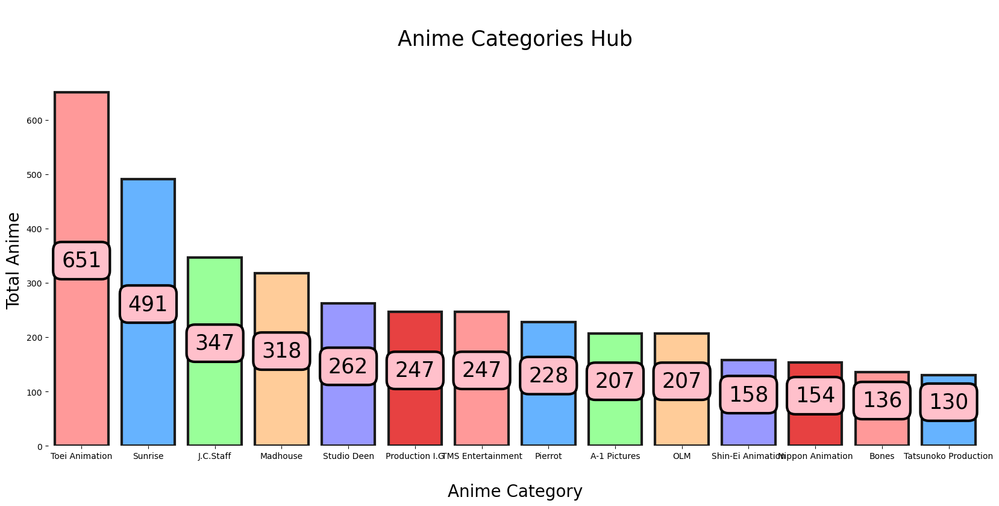

In [15]:
#visualization of how many values are in each type of anime

plt.subplots(figsize = (20,8))
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
p = sns.countplot(x = myanimelist["Studios"], order = myanimelist["Studios"].value_counts()[1:15].index, palette = palette, saturation = 1,  edgecolor = "#1c1c1c", linewidth = 3)
p.axes.set_title("\nAnime Categories Hub\n" ,fontsize = 25)
plt.ylabel("Total Anime" ,fontsize = 20)
plt.xlabel("\nAnime Category" ,fontsize = 20)
plt.xticks(rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type = "center",padding = 10,size = 25, color = "black", rotation = 0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "pink", "edgecolor": "black", "linewidth": 3, "alpha":1})
sns.despine(left = True, bottom = True)
plt.show()

Plotly express is utilizied to depict the percentages of the studios that create anime below as an additional form of understanidng this data in the form of a pie chart.

In [16]:
#creating a pie chart of anime type
type_list = list(studios.unique())

type_values = []

for i in range(len(studios.unique())) :

    type_values.append(studios.value_counts().iloc[i])
    
fig = px.pie(values=type_values,
             names=studios.unique(),
)

fig.update_traces(marker=dict(colors=palette),
                  hole = .3,
                  textposition='inside',
                  textinfo='percent+label'
)

fig.update_layout(
    annotations=[dict(text='Type', x=0.5, y=0.5, font_size=24, showarrow=False)],
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.90,
        xanchor="left",
        x=0.80
    ),
    font=dict(
        color = "purple"
    )
)
fig.show()

In [17]:
general = myanimelist.sort_values(by='MAL_Score', ascending = False)
top_50_rated = myanimelist.head(50)
top_20_rated = myanimelist.head(20)

fig = px.bar(top_20_rated,
             y="Studios",
             x="MAL_Score",
             # orientation='h',
             height=600,
             labels={
                     "Name" : "Anime"
                    },
             color = "Type",
             color_discrete_sequence=palette,
             orientation='h'
            )
fig.update_traces(hovertemplate ='%{y}' + " : " + "%{x}", selector=dict(type="bar"))

fig.update_layout(
    title = "Top Rated Studios & Their Type",
    yaxis_title = "Anime",
    xaxis_range=[5,10],
    yaxis={'categoryorder':'total ascending'},
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.50,
        xanchor="left",
        x=0.80,
        bgcolor="#e6ccff",
        bordercolor="purple",
        borderwidth=1
    ),
    font=dict(
        color = "Purple"
    )
)
fig.show()

The visualization below depicts the types of anime each studios creates compared to the score they recieve by fans.

In [18]:
fig = px.scatter(myanimelist,
y="Studios",
x='MAL_Score',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

### EDA Demographics in MyAnimeList

This section will explore this dataset to better understand the patterns in the demographic of anime. There are 10 types of demographics in this dataset, but 2 have only 1 item each and 1 is Unknown, so those will be dropped. The 5 main demographics:

- Shounen: Created for boys younger than 18, typically action and adventure oriented
- Kids : Created for young children, usually are moralistic, often educating children about staying in the right path in life
- Seinen : Created for men over 18, mature topics of violence and/or psychological nature
- Shoujo : Created for girls younger than 18, typically coming of age and romance oriented
- Josei : Created for women over 18, mature topics of relationships and work life

The superfluous demographic categories are dropped below, leaving 5 categories of demographics.

In [19]:
#number of users
print("Number of demographics:", myanimelist.Demographics.nunique())
print(myanimelist['Demographics'].value_counts()[1:20].sort_values())

# myanimelist = myanimelist[myanimelist['Demographics'].str.contains("Unknown")==False]
# myanimelist = myanimelist[myanimelist['Demographics'].str.contains("Josei, Shoujo")==False]
# myanimelist = myanimelist[myanimelist['Demographics'].str.contains("Kids, Seinen")==False]
# myanimelist = myanimelist[myanimelist['Demographics'].str.contains("Kids, Shoujo")==False]
# myanimelist = myanimelist[myanimelist['Demographics'].str.contains("Kids, Shounen")==False]
# print("Number of demographics:", myanimelist.Demographics.nunique())
# print(myanimelist['Demographics'].value_counts()[0:20].sort_values())


Number of demographics: 10
Josei, Shoujo       1
Kids, Seinen        1
Kids, Shoujo       31
Kids, Shounen      61
Josei              90
Shoujo            626
Seinen            797
Kids              932
Shounen          1814
Name: Demographics, dtype: int64


Shounen has by far the greatest amount of anime with Josei the least. The majority of anime fans are younger and like action oriented anime. 

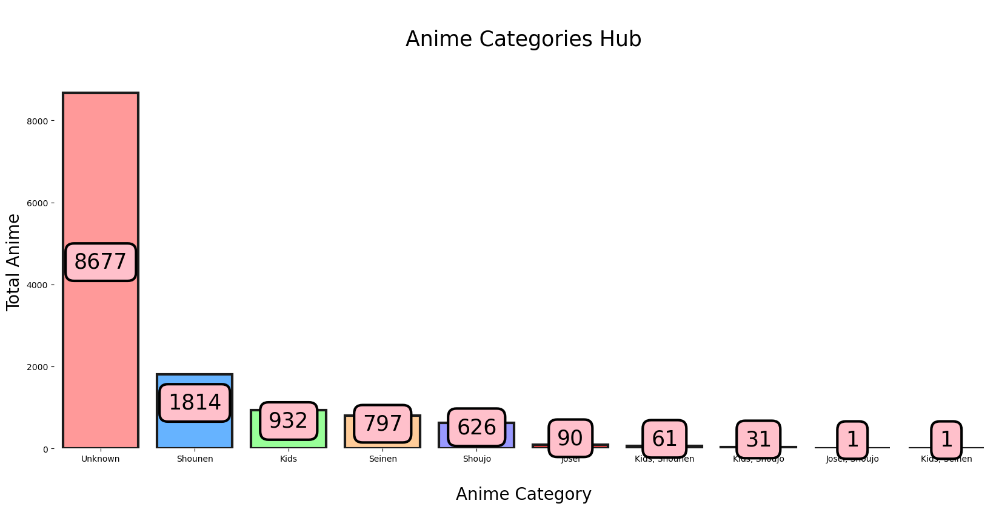

In [20]:
#visualization of how many values are in each type of anime

plt.subplots(figsize = (20,8))
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
p = sns.countplot(x = myanimelist["Demographics"], order = myanimelist["Demographics"].value_counts()[0:15].index, palette = palette, saturation = 1,  edgecolor = "#1c1c1c", linewidth = 3)
p.axes.set_title("\nAnime Categories Hub\n" ,fontsize = 25)
plt.ylabel("Total Anime" ,fontsize = 20)
plt.xlabel("\nAnime Category" ,fontsize = 20)
plt.xticks(rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type = "center",padding = 10,size = 25, color = "black", rotation = 0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "pink", "edgecolor": "black", "linewidth": 3, "alpha":1})
sns.despine(left = True, bottom = True)
plt.show()

Plotly express is utilizied to depict the percentages of the demographics that create anime below as an additional form of understanidng this data in the form of a pie chart.

In [21]:
#creating a pie chart of anime type
type_list = list(myanimelist["Demographics"].unique())

type_values = []

for i in range(len(myanimelist["Demographics"].unique())) :

    type_values.append(myanimelist["Demographics"].value_counts().iloc[i])
    
fig = px.pie(values=type_values,
             names=myanimelist["Demographics"].unique(),
)

fig.update_traces(marker=dict(colors=palette),
                  hole = .3,
                  textposition='inside',
                  textinfo='percent+label'
)

fig.update_layout(
    annotations=[dict(text='Type', x=0.5, y=0.5, font_size=24, showarrow=False)],
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.90,
        xanchor="left",
        x=0.80
    ),
    font=dict(
        color = "purple"
    )
)
fig.show()

The score and type of anime is similar amongst the demographics.

In [22]:
fig = px.scatter(myanimelist,
y="Demographics",
x='MAL_Score',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

### EDA Theme of anime in MyAnimeList

In [23]:
#number of users
print("Number of MAL_Themes:", myanimelist.MAL_Themes.nunique())
print(myanimelist['MAL_Themes'].value_counts()[1:20].sort_values())


print("Number of Themes:", myanimelist.Demographics.nunique())
print(myanimelist['MAL_Themes'].value_counts()[0:20].sort_values())
themes = myanimelist['MAL_Themes'][0:20].sort_values()


Number of MAL_Themes: 685
Mecha, Space               89
Harem                      96
Harem, School             103
Detective                 104
Team Sports               109
Mahou Shoujo              111
Military                  113
Space                     115
Martial Arts              122
Psychological             133
Idols (Female), Music     133
Strategy Game             139
Mythology                 174
Parody                    193
Super Power               210
Historical                391
Mecha                     447
School                    606
Music                    1274
Name: MAL_Themes, dtype: int64
Number of Themes: 10
Mecha, Space               89
Harem                      96
Harem, School             103
Detective                 104
Team Sports               109
Mahou Shoujo              111
Military                  113
Space                     115
Martial Arts              122
Psychological             133
Idols (Female), Music     133
Strategy Game         

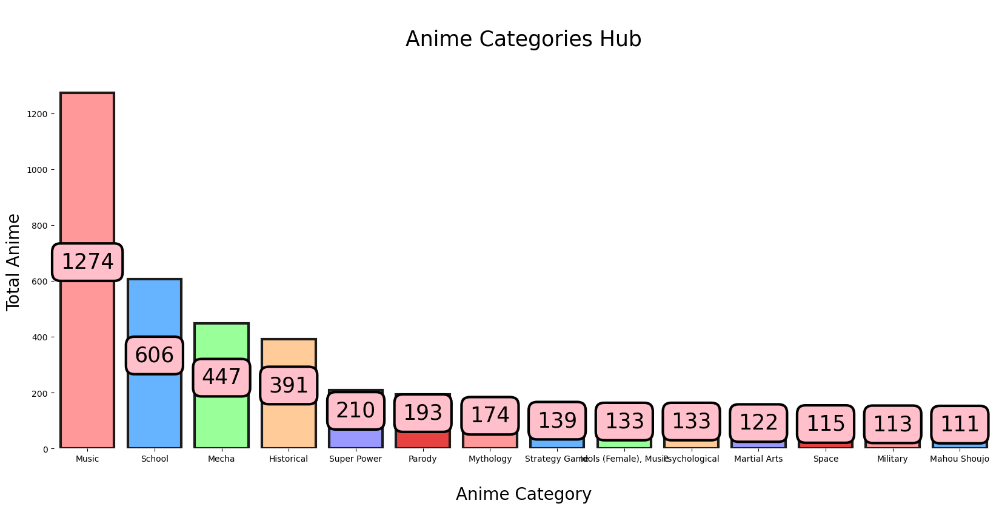

In [24]:
#visualization of how many values are in each type of anime

plt.subplots(figsize = (20,8))
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
p = sns.countplot(x = myanimelist["MAL_Themes"], order = myanimelist["MAL_Themes"].value_counts()[1:15].index, palette = palette, saturation = 1,  edgecolor = "#1c1c1c", linewidth = 3)
p.axes.set_title("\nAnime Categories Hub\n" ,fontsize = 25)
plt.ylabel("Total Anime" ,fontsize = 20)
plt.xlabel("\nAnime Category" ,fontsize = 20)
plt.xticks(rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type = "center",padding = 10,size = 25, color = "black", rotation = 0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "pink", "edgecolor": "black", "linewidth": 3, "alpha":1})
sns.despine(left = True, bottom = True)
plt.show()

In order to show the amount of anime in each category in a different way from a bar chart, a pie chart is displayed below with the percentages of each type of anime in order to further understanding.

In [25]:
myanimelist['MAL_Themes']

0        Gore, Military, Survival
1                   Psychological
2                        Military
3             Parody, Super Power
4        Love Polygon, Video Game
                   ...           
17720                       Music
17737                       Music
17820                       Music
17857       Idols (Female), Music
17988       Idols (Female), Music
Name: MAL_Themes, Length: 13030, dtype: object

In [26]:
#creating a pie chart of anime type
type_list = list(themes.unique())

type_values = []

for i in range(len(themes.unique())) :

    type_values.append(themes.value_counts().iloc[i])
    
fig = px.pie(values=type_values,
             names=themes.unique(),
)

fig.update_traces(marker=dict(colors=palette),
                  hole = .3,
                  textposition='inside',
                  textinfo='percent+label'
)

fig.update_layout(
    annotations=[dict(text='Type', x=0.5, y=0.5, font_size=24, showarrow=False)],
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.90,
        xanchor="left",
        x=0.80
    ),
    font=dict(
        color = "purple"
    )
)
fig.show()

In [27]:
fig = px.scatter(myanimelist,
y="MAL_Themes",
x='MAL_Score',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

In [28]:
general = myanimelist.sort_values(by='MAL_Score', ascending = False)
top_50_rated = myanimelist.head(50)
top_20_rated = myanimelist.head(20)

fig = px.bar(top_20_rated,
             y="MAL_Themes",
             x="MAL_Score",
             # orientation='h',
             height=600,
             labels={
                     "Name" : "Anime"
                    },
             color = "Type",
             color_discrete_sequence=palette,
             orientation='h'
            )
fig.update_traces(hovertemplate ='%{y}' + " : " + "%{x}", selector=dict(type="bar"))

fig.update_layout(
    title = "Top Rated Studios & Their Type",
    yaxis_title = "Anime",
    xaxis_range=[5,10],
    yaxis={'categoryorder':'total ascending'},
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.50,
        xanchor="left",
        x=0.80,
        bgcolor="#e6ccff",
        bordercolor="purple",
        borderwidth=1
    ),
    font=dict(
        color = "Purple"
    )
)
fig.show()

### EDA Genre of anime in MyAnimeList

This section will explore this dataset to better understand the patterns in the genres of anime. There are 10 types of demographics in this dataset, but 2 have only 1 item each and 1 is Unknown, so those will be dropped. The 5 main demographics:

- Shounen: Created for boys younger than 18, typically action and adventure oriented
- Kids : Created for young children, usually are moralistic, often educating children about staying in the right path in life
- Seinen : Created for men over 18, mature topics of violence and/or psychological nature
- Shoujo : Created for girls younger than 18, typically coming of age and romance oriented
- Josei : Created for women over 18, mature topics of relationships and work life

In [29]:
#number of genres
print("Number of MAL_Genres:", myanimelist.MAL_Genres.nunique())
print(myanimelist['MAL_Genres'].value_counts()[0:20].sort_values())

print("Number of Genres:", myanimelist.Demographics.nunique())
print(myanimelist['MAL_Genres'].value_counts()[0:20].sort_values())
genres = myanimelist['MAL_Genres'][0:20].sort_values()


Number of MAL_Genres: 807
Adventure                      147
Adventure, Comedy, Fantasy     150
Action, Adventure, Sci-Fi      151
Comedy, Sci-Fi                 162
Comedy, Fantasy                173
Adventure, Fantasy             184
Comedy, Romance                199
Sci-Fi                         202
Sports                         211
Action, Fantasy                217
Drama                          250
Action, Adventure, Fantasy     256
Avant Garde                    285
Slice of Life                  308
Action                         352
Action, Sci-Fi                 367
Comedy, Slice of Life          396
Fantasy                        398
Comedy                        1094
Unknown                       1487
Name: MAL_Genres, dtype: int64
Number of Genres: 10
Adventure                      147
Adventure, Comedy, Fantasy     150
Action, Adventure, Sci-Fi      151
Comedy, Sci-Fi                 162
Comedy, Fantasy                173
Adventure, Fantasy             184
Comedy, Roma

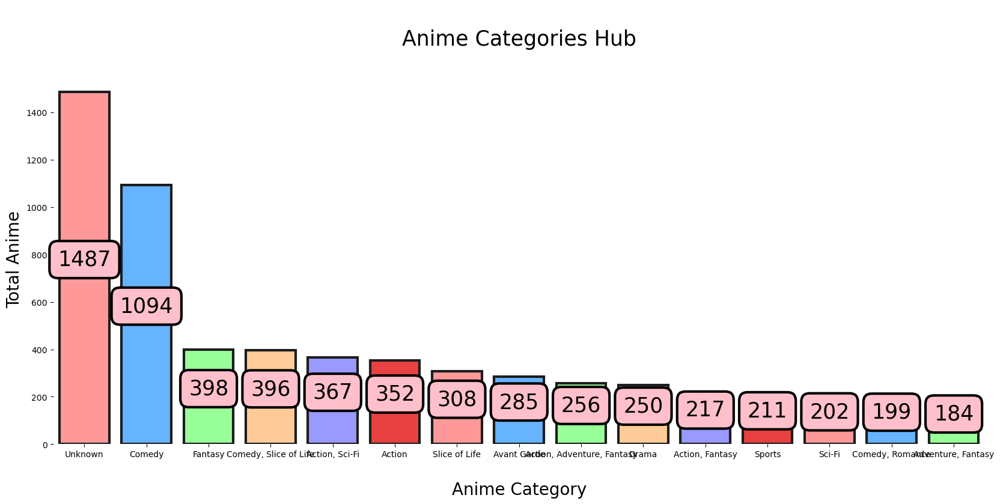

In [30]:
#visualization of how many values are in each type of anime

plt.subplots(figsize = (20,8))
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
p = sns.countplot(x = myanimelist["MAL_Genres"], order = myanimelist["MAL_Genres"].value_counts()[0:15].index, palette = palette, saturation = 1,  edgecolor = "#1c1c1c", linewidth = 3)
p.axes.set_title("\nAnime Categories Hub\n" ,fontsize = 25)
plt.ylabel("Total Anime" ,fontsize = 20)
plt.xlabel("\nAnime Category" ,fontsize = 20)
plt.xticks(rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type = "center",padding = 10,size = 25, color = "black", rotation = 0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "pink", "edgecolor": "black", "linewidth": 3, "alpha":1})
sns.despine(left = True, bottom = True)
plt.show()

In order to show the amount of anime in each category in a different way from a bar chart, a pie chart is displayed below with the percentages of each type of anime in order to further understanding.

In [31]:
#creating a pie chart of anime type
type_list = list(genres.unique())

type_values = []

for i in range(len(genres.unique())) :

    type_values.append(genres.value_counts().iloc[i])
    
fig = px.pie(values=type_values,
             names=genres.unique(),
)

fig.update_traces(marker=dict(colors=palette),
                  hole = .3,
                  textposition='inside',
                  textinfo='percent+label'
)

fig.update_layout(
    annotations=[dict(text='Type', x=0.5, y=0.5, font_size=24, showarrow=False)],
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.90,
        xanchor="left",
        x=0.80
    ),
    font=dict(
        color = "purple"
    )
)
fig.show()

<AxesSubplot: title={'center': 'Most Popular Genres MY Anime List'}, xlabel='Genres', ylabel='Genres'>

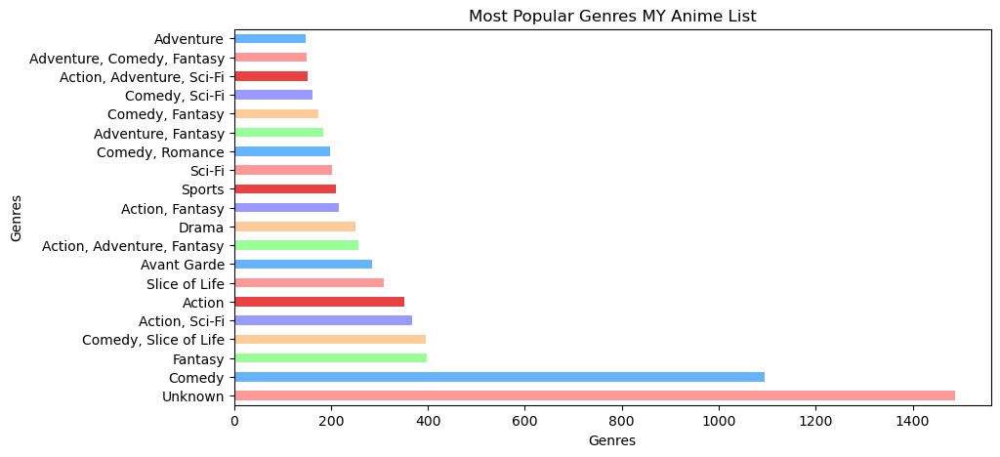

In [32]:
myanimelist['MAL_Genres'].value_counts(ascending = False)[:20].plot(title = 'Most Popular Genres MY Anime List', xlabel = 'Genres', ylabel = 'Genres', figsize=(10,5), kind='barh', color =palette)

In [33]:
fig = px.scatter(myanimelist,
y="MAL_Genres",
x='MAL_Score',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

### EDA Members of anime in MyAnimeList

In [34]:
#number of users
print("Number of Users:", myanimelist.MAL_Members.nunique())

avg_rate_peruser = myanimelist.shape[0]
user = myanimelist.MAL_Members.nunique()
avg_num_review_per_user = avg_rate_peruser/user
print("Average Number of Reveiws per User:", avg_num_review_per_user)
print("Users:", myanimelist['MAL_Members'].value_counts())

Number of Users: 9307
Average Number of Reveiws per User: 1.4000214892016762
Users: 402      14
316      12
718      11
681      11
358      10
         ..
36777     1
36778     1
36712     1
36702     1
172       1
Name: MAL_Members, Length: 9307, dtype: int64


In [35]:
fig = px.scatter(myanimelist,
y="MAL_Members",
x='MAL_Score',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

In [36]:
fig = px.scatter(myanimelist,
y="MAL_Score",
x='MAL_Members',
color = "Studios",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

In [37]:
fig = px.scatter(myanimelist,
y="MAL_Members",
x='MAL_Score',
color = "MAL_Popularity",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

### EDA Source in MyAnimeList

This section will explore this dataset to better understand the patterns in the sources of anime. There are 10 types of sources in this dataset:

- Light Novel: style of young adult novel primarily targeting high school and middle school students

- Manga : comics or graphic novels originating from Japan

- Web manga : manga published on a website or mobile app

- Novel : a relatively long work of narrative fiction, typically written in prose and published as a book

- 4-koma manga :  comic strip format, generally consists of gag comic strips within four panels of equal size ordered from top to bottom

- Game : an electronic game that involves interaction with a user interface or input device to generate visual feedback from a display device

- Visual novel : a form of digital semi-interactive fiction

- Original : created originally for anime format

- Music : created to accompany a song or album

- Other

<AxesSubplot: xlabel='Source'>

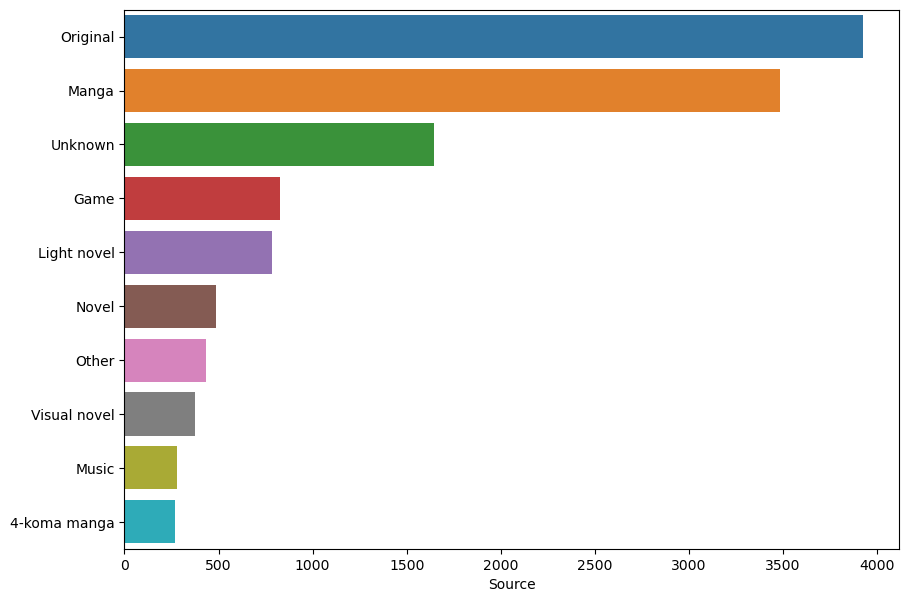

In [38]:
#barplot of number of sources of anime
source_top10= myanimelist['Source'].value_counts().head(10).index
nsource_top10 = myanimelist['Source'].value_counts().head(10)

plt.figure(figsize=(10,7))
sns.barplot( x = nsource_top10, y= source_top10)

# filsource_top10 = myanimelist[myanimelist['Source'].isin(source_top10)]
# source_score_median_top10 = myanimelist.groupby(['Source'], as_index = False).agg({'Source' : 'median'}).sort_values('Score' , ascending = False)

# plt.figure(figsize(15,8))
# sbs.boxplot(x = 'Source', y= 'Source', data = filsource_top10, order =source_score_median_top10['Source '])

In [39]:
# #boxplot top10 of source

# filsource_top10 = myanimelist[myanimelist['Source'].isin(source_top10)]
# source_score_median_top10 = myanimelist.groupby(['Source'], as_index = False).agg({'Source' : 'median'}).sort_values('Score' , ascending = False)

# plt.figure(figsize(15,8))
# sbs.boxplot(x = 'Source', y= 'Source', data = filsource_top10, order =source_score_median_top10['Source '])

### Correlation between MyAnimeList Attributes

The correlation between attributes as shown bellow in the correlation matrix heatmap do not show many strong correlations between many of the attributes. 

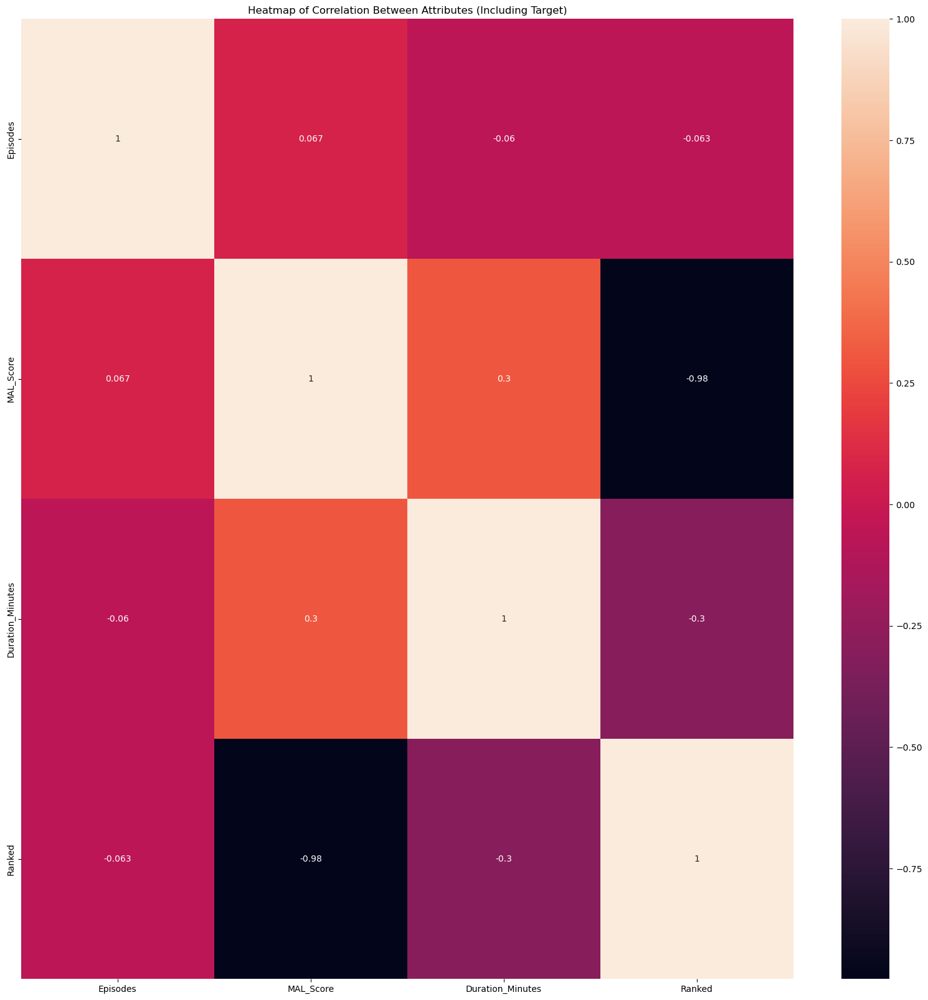

In [40]:
corr_mat = myanimelist[['Type', 'Episodes', 'Studios','MAL_Score', 'Duration_Minutes', 'Ranked', 'Source', 'Start_Aired', 'MAL_Genres']].corr()
fig, ax = plt.subplots(figsize=(20, 20))
# plot it
sns.heatmap(corr_mat, annot = True)
ax.set_title("Heatmap of Correlation Between Attributes (Including Target)");

The distribution of categorical and ordinal data is shown below. 

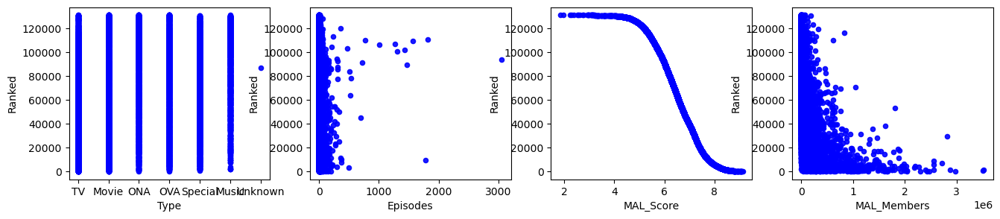

In [41]:
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(16,3))
for xcol, ax in zip(['Type', 'Episodes', 'MAL_Score','MAL_Members'], axes):
    myanimelist.plot(kind='scatter', x=xcol, y='Ranked', ax=ax, alpha=0.9, color = 'b')

## Dataset 2 : Box Office Mojo Anime

I scraped data from Box Office Mojo's Anime movie grossing list in order to understand what anime is top in terms of money in constrast to popularity in MyAnimeList. I checked the website with \robot.txt to make sure that it was okay to scrap the data and then utilized Beautiful Soup to transform the data into a dataset.

In [42]:
URL = "https://www.boxofficemojo.com/genre/sg4259246337/"
r = requests.get(URL)
content = r.text
print(content)

<!doctype html><html class="a-no-js" data-19ax5a9jf="dingo"><head><script>var aPageStart = (new Date()).getTime();</script><meta charset="utf-8"/>
<script type='text/javascript'>var ue_t0=ue_t0||+new Date();</script>
<script type='text/javascript'>
window.ue_ihb = (window.ue_ihb || window.ueinit || 0) + 1;
if (window.ue_ihb === 1) {

var ue_csm = window,
    ue_hob = +new Date();
(function(d){var e=d.ue=d.ue||{},f=Date.now||function(){return+new Date};e.d=function(b){return f()-(b?0:d.ue_t0)};e.stub=function(b,a){if(!b[a]){var c=[];b[a]=function(){c.push([c.slice.call(arguments),e.d(),d.ue_id])};b[a].replay=function(b){for(var a;a=c.shift();)b(a[0],a[1],a[2])};b[a].isStub=1}};e.exec=function(b,a){return function(){try{return b.apply(this,arguments)}catch(c){ueLogError(c,{attribution:a||"undefined",logLevel:"WARN"})}}}})(ue_csm);


    var ue_err_chan = 'jserr-rw';
(function(d,e){function h(f,b){if(!(a.ec>a.mxe)&&f){a.ter.push(f);b=b||{};var c=f.logLevel||b.logLevel;c&&c!==k&&c!==m&&c!=

In [43]:
soup = BeautifulSoup(r.content, "html.parser")
print(soup.prettify())

<!DOCTYPE html>
<html class="a-no-js" data-19ax5a9jf="dingo">
 <head>
  <script>
   var aPageStart = (new Date()).getTime();
  </script>
  <meta charset="utf-8"/>
  <script type="text/javascript">
   var ue_t0=ue_t0||+new Date();
  </script>
  <script type="text/javascript">
   window.ue_ihb = (window.ue_ihb || window.ueinit || 0) + 1;
if (window.ue_ihb === 1) {

var ue_csm = window,
    ue_hob = +new Date();
(function(d){var e=d.ue=d.ue||{},f=Date.now||function(){return+new Date};e.d=function(b){return f()-(b?0:d.ue_t0)};e.stub=function(b,a){if(!b[a]){var c=[];b[a]=function(){c.push([c.slice.call(arguments),e.d(),d.ue_id])};b[a].replay=function(b){for(var a;a=c.shift();)b(a[0],a[1],a[2])};b[a].isStub=1}};e.exec=function(b,a){return function(){try{return b.apply(this,arguments)}catch(c){ueLogError(c,{attribution:a||"undefined",logLevel:"WARN"})}}}})(ue_csm);


    var ue_err_chan = 'jserr-rw';
(function(d,e){function h(f,b){if(!(a.ec>a.mxe)&&f){a.ter.push(f);b=b||{};var c=f.logLevel||b

In [44]:
print(soup.table.text)

Rank
Title
Lifetime GrossMax TheatersOpeningOpen ThRelease DateDistributor
1Pokémon: The First Movie - Mewtwo Strikes Back$85,744,6623,043$31,036,6783,043Nov 10, 1999Warner Bros.

2Demon Slayer the Movie: Mugen Train$49,505,0082,087$21,234,9941,614Apr 23, 2021FUNimation Entertainment

3Pokémon the Movie 2000$43,758,6842,752$19,575,6082,752Jul 21, 2000Warner Bros.

4Dragon Ball Super: Super Hero$38,112,1403,018$21,126,9193,018Aug 19, 2022Crunchyroll

5Jujutsu Kaisen 0: The Movie$34,542,7542,418$18,009,9212,286Mar 18, 2022Crunchyroll

6Dragon Ball Super: Broly$30,712,1191,267$9,816,1971,238Jan 16, 2019FUNimation Entertainment

7Yu-Gi-Oh!: The Movie - Pyramid of Light$19,765,8682,411$9,485,4942,411Aug 13, 2004Warner Bros.

8The Secret World of Arrietty$19,202,7431,522$6,446,3951,522Feb 17, 2012Walt Disney Studios Motion Pictures

9Pokémon 3 the Movie: Spell of the Unown$17,052,1282,675$8,240,7522,675Apr 6, 2001Warner Bros.

10Ponyo$15,090,399927$3,585,852927Aug 14, 2009Walt Disney Studios

In [45]:
table = soup.find_all('table')[0] 
tab_data = [[celldata.text for celldata in rowdata.find_all(["th","td"])]
            for rowdata in table.find_all("tr")]
for data in tab_data:
    print(' '.join(data))

Rank
 Title
 Lifetime Gross Max Theaters Opening Open Th Release Date Distributor

1 Pokémon: The First Movie - Mewtwo Strikes Back $85,744,662 3,043 $31,036,678 3,043 Nov 10, 1999 Warner Bros.


2 Demon Slayer the Movie: Mugen Train $49,505,008 2,087 $21,234,994 1,614 Apr 23, 2021 FUNimation Entertainment


3 Pokémon the Movie 2000 $43,758,684 2,752 $19,575,608 2,752 Jul 21, 2000 Warner Bros.


4 Dragon Ball Super: Super Hero $38,112,140 3,018 $21,126,919 3,018 Aug 19, 2022 Crunchyroll


5 Jujutsu Kaisen 0: The Movie $34,542,754 2,418 $18,009,921 2,286 Mar 18, 2022 Crunchyroll


6 Dragon Ball Super: Broly $30,712,119 1,267 $9,816,197 1,238 Jan 16, 2019 FUNimation Entertainment


7 Yu-Gi-Oh!: The Movie - Pyramid of Light $19,765,868 2,411 $9,485,494 2,411 Aug 13, 2004 Warner Bros.


8 The Secret World of Arrietty $19,202,743 1,522 $6,446,395 1,522 Feb 17, 2012 Walt Disney Studios Motion Pictures


9 Pokémon 3 the Movie: Spell of the Unown $17,052,128 2,675 $8,240,752 2,675 Apr 6, 2001 

This box office data is depicted below with 8 columns consisting of the title of the movies, lifetime gross, max theaters,opening amount, release date and distributor.

In [46]:


# Read the table into a Pandas DataFrame
df = pd.read_html(str(table))[0]
df


,Rank,Title,Lifetime Gross,Max Theaters,Opening,Open Th,Release Date,Distributor
0,1,Pokémon: The First Movie - Mewtwo Strikes Back,"$85,744,662",3043,"$31,036,678",3043,"Nov 10, 1999",Warner Bros.
1,2,Demon Slayer the Movie: Mugen Train,"$49,505,008",2087,"$21,234,994",1614,"Apr 23, 2021",FUNimation Entertainment
2,3,Pokémon the Movie 2000,"$43,758,684",2752,"$19,575,608",2752,"Jul 21, 2000",Warner Bros.
3,4,Dragon Ball Super: Super Hero,"$38,112,140",3018,"$21,126,919",3018,"Aug 19, 2022",Crunchyroll
4,5,Jujutsu Kaisen 0: The Movie,"$34,542,754",2418,"$18,009,921",2286,"Mar 18, 2022",Crunchyroll
...,...,...,...,...,...,...,...,...
95,96,Summer Wars,"$80,768",11,"$1,412",1,"Dec 24, 2010",GKIDS
96,97,Wonderful Days,"$74,663",5,"$3,022",1,"Dec 31, 2004",-
97,98,A Letter to Momo,"$71,712",7,"$4,596",1,"Jul 23, 2014",GKIDS
98,99,Trigun: Badlands Rumble,"$62,027",12,"$29,201",12,"Jul 8, 2011",Eleven Arts


In [47]:
print(df.head())
df.value_counts()

   Rank                                           Title Lifetime Gross  \
0     1  Pokémon: The First Movie - Mewtwo Strikes Back    $85,744,662   
1     2             Demon Slayer the Movie: Mugen Train    $49,505,008   
2     3                          Pokémon the Movie 2000    $43,758,684   
3     4                   Dragon Ball Super: Super Hero    $38,112,140   
4     5                     Jujutsu Kaisen 0: The Movie    $34,542,754   

   Max Theaters      Opening Open Th  Release Date               Distributor  
0          3043  $31,036,678    3043  Nov 10, 1999              Warner Bros.  
1          2087  $21,234,994    1614  Apr 23, 2021  FUNimation Entertainment  
2          2752  $19,575,608    2752  Jul 21, 2000              Warner Bros.  
3          3018  $21,126,919    3018  Aug 19, 2022               Crunchyroll  
4          2418  $18,009,921    2286  Mar 18, 2022               Crunchyroll  


Rank  Title                                                                   Lifetime Gross  Max Theaters  Opening      Open Th  Release Date  Distributor  
1     Pokémon: The First Movie - Mewtwo Strikes Back                          $85,744,662     3043          $31,036,678  3043     Nov 10, 1999  Warner Bros.     1
64    April and the Extraordinary World                                       $295,488        35            $11,413      1        Mar 25, 2016  GKIDS            1
74    Mazinger Z: INFINITY                                                    $220,682        495           $137,451     482      Feb 11, 2018  Fathom Events    1
73    Miss Hokusai                                                            $222,670        84            $24,524      2        Oct 14, 2016  GKIDS            1
72    Millennium Actress                                                      $225,250        512           -            -        Aug 13, 2019  Fathom Events    1
                           

In [48]:
print(df.isnull().sum())
df.dropna(inplace=True)
print(df.head(5))
print(df.isnull().sum())
print(f"Total number of records: {len(df)}")

Rank              0
Title             0
Lifetime Gross    0
Max Theaters      0
Opening           0
Open Th           0
Release Date      0
Distributor       0
dtype: int64
   Rank                                           Title Lifetime Gross  \
0     1  Pokémon: The First Movie - Mewtwo Strikes Back    $85,744,662   
1     2             Demon Slayer the Movie: Mugen Train    $49,505,008   
2     3                          Pokémon the Movie 2000    $43,758,684   
3     4                   Dragon Ball Super: Super Hero    $38,112,140   
4     5                     Jujutsu Kaisen 0: The Movie    $34,542,754   

   Max Theaters      Opening Open Th  Release Date               Distributor  
0          3043  $31,036,678    3043  Nov 10, 1999              Warner Bros.  
1          2087  $21,234,994    1614  Apr 23, 2021  FUNimation Entertainment  
2          2752  $19,575,608    2752  Jul 21, 2000              Warner Bros.  
3          3018  $21,126,919    3018  Aug 19, 2022               C

## Merge DataSets


In order to compare and contrast some aspects of the anime, the two datasets (MyAnimeList and Box Office Mojo) are merged together into one dataset.

In [49]:
#merge the two datasets together
anime = pd.concat([myanimelist.reset_index(drop=True), df.reset_index(drop = True)], axis =1)
print(anime.columns)
anime.head()


Index(['ID', 'MAL_Title', 'Synonyms', 'Japanese', 'English', 'Synopsis',
       'Type', 'Episodes', 'Status', 'Start_Aired', 'End_Aired', 'Premiered',
       'Broadcast', 'Producers', 'Licensors', 'Studios', 'Source',
       'MAL_Genres', 'MAL_Themes', 'Demographics', 'Duration_Minutes',
       'MAL_Rating', 'MAL_Score', 'Scored_Users', 'Ranked', 'MAL_Popularity',
       'MAL_Members', 'Favorites', 'Rank', 'Title', 'Lifetime Gross',
       'Max Theaters', 'Opening', 'Open Th', 'Release Date', 'Distributor'],
      dtype='object')


,ID,MAL_Title,Synonyms,Japanese,English,Synopsis,Type,Episodes,Status,Start_Aired,...,MAL_Members,Favorites,Rank,Title,Lifetime Gross,Max Theaters,Opening,Open Th,Release Date,Distributor
0,16498,Shingeki no Kyojin,"AoT, SnK",é²æã®å·¨äºº,Attack on Titan,"Centuries ago, mankind was slaughtered to near...",TV,25.0,Finished Airing,"Apr 7, 2013",...,3524109,155695,1.0,Pokémon: The First Movie - Mewtwo Strikes Back,"$85,744,662",3043.0,"$31,036,678",3043,"Nov 10, 1999",Warner Bros.
1,1535,Death Note,DN,ãã¹ãã¼ã,Death Note,"Brutal murders, petty thefts, and senseless vi...",TV,37.0,Finished Airing,"Oct 4, 2006",...,3504535,159701,2.0,Demon Slayer the Movie: Mugen Train,"$49,505,008",2087.0,"$21,234,994",1614,"Apr 23, 2021",FUNimation Entertainment
2,5114,Fullmetal Alchemist: Brotherhood,"Hagane no Renkinjutsushi Fullmetal Alchemist, ...",é¼ã®é¬éè¡å¸« FULLMETAL ALCHEMIST,Fullmetal Alchemist Brotherhood,After a horrific alchemy experiment goes wrong...,TV,64.0,Finished Airing,"Apr 5, 2009",...,2978455,207772,3.0,Pokémon the Movie 2000,"$43,758,684",2752.0,"$19,575,608",2752,"Jul 21, 2000",Warner Bros.
3,30276,One Punch Man,"One Punch-Man, One-Punch Man, OPM",ã¯ã³ãã³ãã³,One Punch Man,The seemingly unimpressive Saitama has a rathe...,TV,12.0,Finished Airing,"Oct 5, 2015",...,2879907,59651,4.0,Dragon Ball Super: Super Hero,"$38,112,140",3018.0,"$21,126,919",3018,"Aug 19, 2022",Crunchyroll
4,11757,Sword Art Online,"S.A.O, SAO",ã½ã¼ãã¢ã¼ãã»ãªã³ã©ã¤ã³,Sword Art Online,Ever since the release of the innovative Nerve...,TV,25.0,Finished Airing,"Jul 8, 2012",...,2813565,64997,5.0,Jujutsu Kaisen 0: The Movie,"$34,542,754",2418.0,"$18,009,921",2286,"Mar 18, 2022",Crunchyroll


In [50]:
print(f"Total number of records: {len(anime)}")

Total number of records: 13030


## EDA for merged dataset

The correlation between attributes as shown bellow in the correlation matrix heatmap do not show many strong correlations between many of the attributes.

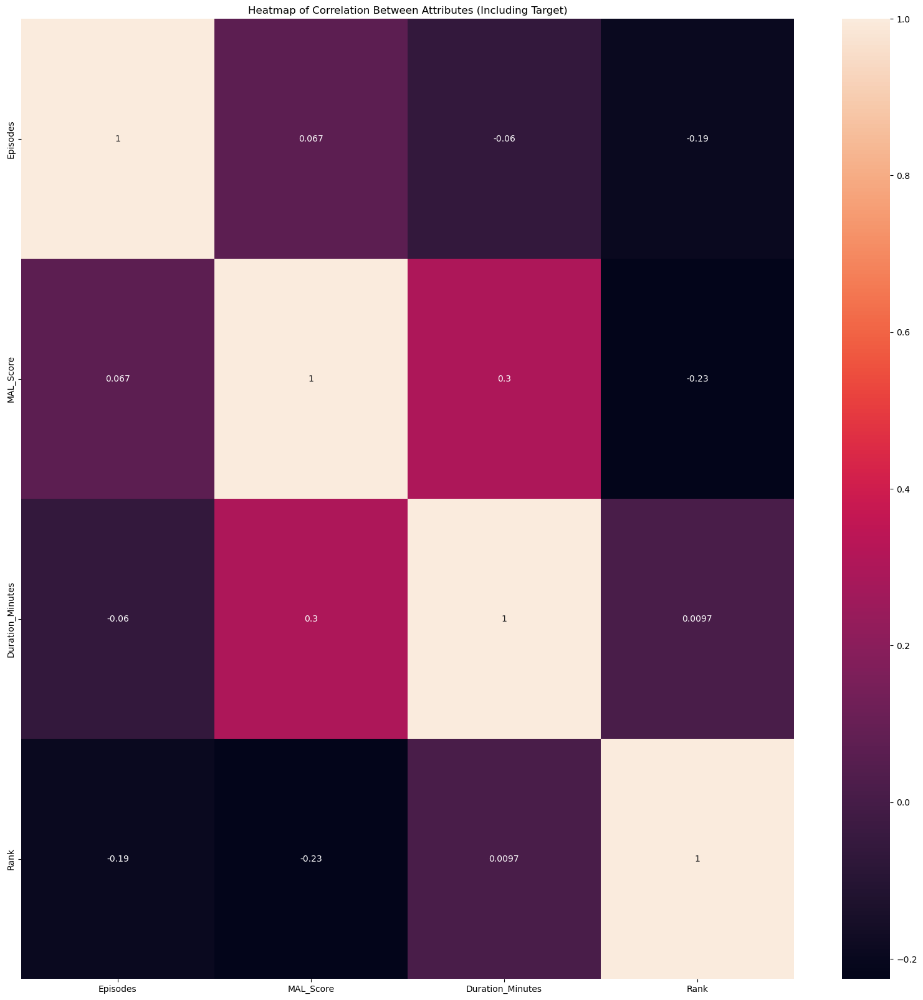

In [51]:
corr_mat = anime[['Type', 'Episodes', 'Studios','MAL_Score', 'Duration_Minutes', 'Rank', 'Source', 'Start_Aired', 'MAL_Genres', 'Lifetime Gross', 'Opening']].corr()
fig, ax = plt.subplots(figsize=(20, 20))
# plot it
sns.heatmap(corr_mat, annot = True)
ax.set_title("Heatmap of Correlation Between Attributes (Including Target)");

The distribution of distributors of the anime are depicted below. Fanthom events distributed the most movies with funimation in 2nd place.

In [52]:
data = anime['Distributor'].value_counts().sort_index(ascending=False)
trace = go.Bar(x = data.index,
               text = ['{:.1f} %'.format(val) for val in (data.values / anime.shape[0] * 100)],
               textposition = 'auto',
               textfont = dict(color = '#000000'),
               y = data.values,
              )
layout = dict(title = 'Distribution Of {} anime-ratings'.format(anime.shape[0]),
              xaxis = dict(title = 'Lifetime Gross'),
              yaxis = dict(title = 'Count'))

fig = go.Figure(data=[trace], layout=layout)
iplot(fig)


In [53]:
general_2 = anime.sort_values(by='Lifetime Gross', ascending = False)
top_50_rated = anime.head(50)
top_20_rated = anime.head(20)

fig = px.bar(top_20_rated,
             y="Title",
             x="Lifetime Gross",
             # orientation='h',
             height=600,
             labels={
                 "Name" : "Anime"
             },
             color = "Distributor",
             color_discrete_sequence=palette,
             orientation='h'
            )

fig.update_traces(hovertemplate ='%{y}' + " : " + "%{x}", selector=dict(type="bar"))

fig.update_layout(
    title = "Top Box office & Their Distributor",
    yaxis_title = "Anime",
    xaxis_range=[5,10],
    yaxis={'categoryorder':'total ascending'},
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.50,
        xanchor="left",
        x=0.80,
        bgcolor="#e6ccff",
        bordercolor="purple",
        borderwidth=1
    ),
    font=dict(
        color = "Purple"
    )
)
fig.show()

In [54]:
anime.shape

(13030, 36)

## Text Preprocessing: Tokenizing

Tokenizing is an important aspect of text classification because it will allow the program to understand the text
better before modeling. Semantic understanding is more difficult than numbers for computer programs to 
analyze, so these steps aid to make the process smoother. The cell below takes a sample document through the
preprocessing steps to pratice and also understand how the steps perform on the data before applying it to the
full data

In the cell below we apply the preprocessing steps to the full data, which includes converting all the words to
lowercase letters, stopword removal, lemmatization and tagging.

In [55]:
#text pre-processing steps:

#convert to lowercase, strip and remove punctuations
def preprocess(text):
    text = text.lower()
    text=text.strip()
    text=re.compile('<.*?>').sub('', text)
    text = re.compile('[%s]' % re.escape(string.punctuation)).sub(' ', text)
    text = re.sub('\s+', ' ', text)
    text = re.sub(r'\[[0-9]*\]',' ',text)
    text=re.sub(r'[^\w\s]', '', str(text).lower().strip())
    text = re.sub(r'\d',' ',text)
    text = re.sub(r'\s+',' ',text)
    return text


# STOPWORD REMOVAL
def stopword(string):
    a= [i for i in string.split() if i not in stopwords.words('english')]
    return ' '.join(a)


#LEMMATIZATION
# Initialize the lemmatizer
wl = WordNetLemmatizer()


# This is a helper function to map NTLK position tags
def get_wordnet_pos(tag):
    if tag.startswith('J'):
        return wordnet.ADJ
    elif tag.startswith('V'):
        return wordnet.VERB
    elif tag.startswith('N'):
        return wordnet.NOUN
    elif tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN
    
# Tokenize the sentence with lemmatization
                                                          
def lemmatizer(string):
    word_pos_tags = nltk.pos_tag(word_tokenize(string)) # Get position tags
    a=[wl.lemmatize(tag[0], get_wordnet_pos(tag[1])) for idx, tag in enumerate(word_pos_tags)] # Map the position tag and Lemmatize the word/token
    return " ".join(a)

In [56]:
#applying the final function of all the text pre-process onto the corpus, creating a new column


def finalpreprocess(string):
    return lemmatizer(stopword(preprocess(string)))
anime['clean_text'] = anime['Synopsis'].apply(lambda x: finalpreprocess(x))
anime.head()

,ID,MAL_Title,Synonyms,Japanese,English,Synopsis,Type,Episodes,Status,Start_Aired,...,Favorites,Rank,Title,Lifetime Gross,Max Theaters,Opening,Open Th,Release Date,Distributor,clean_text
0,16498,Shingeki no Kyojin,"AoT, SnK",é²æã®å·¨äºº,Attack on Titan,"Centuries ago, mankind was slaughtered to near...",TV,25.0,Finished Airing,"Apr 7, 2013",...,155695,1.0,Pokémon: The First Movie - Mewtwo Strikes Back,"$85,744,662",3043.0,"$31,036,678",3043,"Nov 10, 1999",Warner Bros.,century ago mankind slaughter near extinction ...
1,1535,Death Note,DN,ãã¹ãã¼ã,Death Note,"Brutal murders, petty thefts, and senseless vi...",TV,37.0,Finished Airing,"Oct 4, 2006",...,159701,2.0,Demon Slayer the Movie: Mugen Train,"$49,505,008",2087.0,"$21,234,994",1614,"Apr 23, 2021",FUNimation Entertainment,brutal murder petty theft senseless violence p...
2,5114,Fullmetal Alchemist: Brotherhood,"Hagane no Renkinjutsushi Fullmetal Alchemist, ...",é¼ã®é¬éè¡å¸« FULLMETAL ALCHEMIST,Fullmetal Alchemist Brotherhood,After a horrific alchemy experiment goes wrong...,TV,64.0,Finished Airing,"Apr 5, 2009",...,207772,3.0,Pokémon the Movie 2000,"$43,758,684",2752.0,"$19,575,608",2752,"Jul 21, 2000",Warner Bros.,horrific alchemy experiment go wrong elric hou...
3,30276,One Punch Man,"One Punch-Man, One-Punch Man, OPM",ã¯ã³ãã³ãã³,One Punch Man,The seemingly unimpressive Saitama has a rathe...,TV,12.0,Finished Airing,"Oct 5, 2015",...,59651,4.0,Dragon Ball Super: Super Hero,"$38,112,140",3018.0,"$21,126,919",3018,"Aug 19, 2022",Crunchyroll,seemingly unimpressive saitama rather unique h...
4,11757,Sword Art Online,"S.A.O, SAO",ã½ã¼ãã¢ã¼ãã»ãªã³ã©ã¤ã³,Sword Art Online,Ever since the release of the innovative Nerve...,TV,25.0,Finished Airing,"Jul 8, 2012",...,64997,5.0,Jujutsu Kaisen 0: The Movie,"$34,542,754",2418.0,"$18,009,921",2286,"Mar 18, 2022",Crunchyroll,ever since release innovative nervegear gamers...


# Feature Engineering

Feature engineering aids in creating better models through manipulating, standardizing, extracting, and
preparing the data. Below we perform a train test split in order to keep a percentage of data from manipulation for a good measure against the models.

In [57]:
Score = pd.DataFrame(anime["MAL_Score"]).round()
Score

,MAL_Score
0,9.0
1,9.0
2,9.0
3,9.0
4,7.0
...,...
13025,6.0
13026,7.0
13027,6.0
13028,6.0


In [58]:
#SPLITTING THE TRAINING DATASET INTO TRAIN AND TEST

X = anime["clean_text"]

y = Score


X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=42)
                                                   

In [59]:
#vectorizing the data in order to properly analyze in modeling
sw = stopwords.words('english')
vec = CountVectorizer(token_pattern=r"([a-zA-Z]+(?:'[a-z]+)?)", stop_words=sw)
X = vec.fit_transform(anime['clean_text'])
X_train_vec = vec.fit_transform(X_train)
X_train_vec = pd.DataFrame.sparse.from_spmatrix(X_train_vec)
X_train_vec.columns = sorted(vec.vocabulary_)
X_train_vec.set_index(y_train.index, inplace = True)
#Normalize the data with StandardScaler to prevent any data leakage
ss = StandardScaler(with_mean=False)
X_train_ss = ss.fit_transform(X_train_vec)
X_train_ss = X_train_ss.toarray()
#vectorizing and normalizing the data with StandardScaler for the X_test
X_test_vec = vec.transform(X_test)
X_test_vec =pd.DataFrame.sparse.from_spmatrix(X_test_vec)
X_test_vec.columns = sorted(vec.vocabulary_)
X_test_vec.set_index(y_test.index, inplace = True)
X_test_ss = ss.fit_transform(X_test_vec)
#vectorizing the data in order to properly analyze in modeling
X = vec.fit_transform(anime['clean_text'])
X_train_vec = vec.fit_transform(X_train)
X_train_vec = pd.DataFrame.sparse.from_spmatrix(X_train_vec)
X_train_vec.columns = sorted(vec.vocabulary_)
X_train_vec.set_index(y_train.index, inplace = True)


In [60]:
#checking the data to ensure properly vectorized
X_train_vec.set_index(y_train.index)

,aa,aaa,aah,aanimationn,aaron,aast,aasu,aaya,ab,aback,...,zuruggu,zushioumaru,zutomayo,zutto,zuuma,zuzu,zvezda,zwei,zygarde,zz
12870,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9239,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1886,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3003,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
23,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11964,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5191,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5390,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
860,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Frequency of Words Appearing in Anime Dataset

In order to further understand the synopses of anime and to look further into understanding each theme or genre the synpopses depict, a frequency distribution is utilized below. 

In [61]:
anime.clean_text

0        century ago mankind slaughter near extinction ...
1        brutal murder petty theft senseless violence p...
2        horrific alchemy experiment go wrong elric hou...
3        seemingly unimpressive saitama rather unique h...
4        ever since release innovative nervegear gamers...
                               ...                        
13025                                              unknown
13026                  animate music video song mr yoasobi
13027    greenlights serenade original song omoi featur...
13028                     music video song heart beat azki
13029                                              unknown
Name: clean_text, Length: 13030, dtype: object

In [62]:
#Frequency Distribution to see what words were more commonly written throughout the tweets
freq_dist = FreqDist(X_test_vec)
print(freq_dist)
print("\n")
top_25 = X_train_vec.sum().sort_values(ascending=False)[:25].index
print(top_25)


<FreqDist with 30828 samples and 30828 outcomes>


Index(['source', 'one', 'world', 'write', 'mal', 'rewrite', 'school', 'girl',
       'new', 'life', 'year', 'find', 'however', 'take', 'friend', 'day',
       'time', 'make', 'become', 'ann', 'two', 'story', 'name', 'young',
       'live'],
      dtype='object')


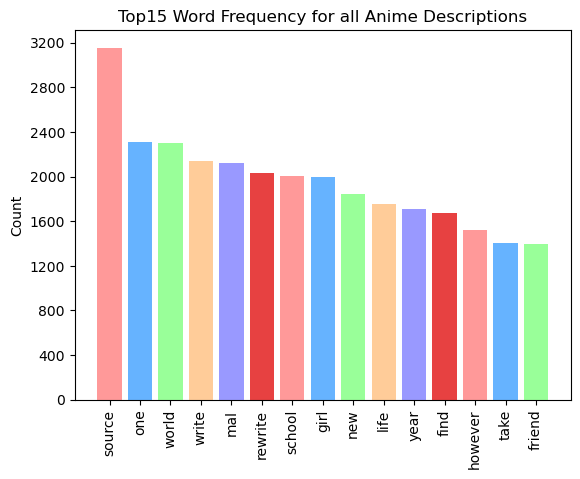

In [63]:
def visualize_top_25(freq_dist, title):
# Extract data for plotting
    top_15 = list(zip(*freq_dist.most_common(15)))
    tokens = top_25[0]
    counts = top_25[1]
# Set up plot and plot data
fig, ax = plt.subplots()
color= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E7414']
ax.bar(X_train_vec.sum().sort_values(ascending=False)[:15].index, X_train_vec.sum().sort_values(ascending=False)[:15], color = palette)
# Customize plot appearance
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
ax.set_title("Top15 Word Frequency for all Anime Descriptions")
ax.set_ylabel("Count")
ax.yaxis.set_major_locator(MaxNLocator(integer=True))
ax.tick_params(axis="x", rotation=90)
visualize_top_25(freq_dist, "Top15 Word Frequency for all Anime Descriptions")

In [64]:
anime.shape

(13030, 37)

## Modeling - supervised

The supervised base models below will be trained on the data in order to uncover which might be best to hypertune. These models are trained on the clean text synopses in order to predict the rating of the anime.

In [65]:
#instantiating models within a dictionary in order to establish baselin
models = {}
# Logistic Regression
models['Logistic Regression'] = LogisticRegression()
# Support Vector Machines
models['Support Vector Machines'] = LinearSVC()
# Stochastic Gradient Descent
models['Stochastic Gradient Descent'] = SGDClassifier()
# Random Forest
models['Random Forest'] = RandomForestClassifier()
# Naive Bayes
models['Naive Bayes'] = GaussianNB()
# K-Nearest Neighbors
models['K-Nearest Neighbor'] = KNeighborsClassifier()

In [66]:
#looking for accuracy, precision and recall scores within the baseline

# from sklearn import preprocessing
# from sklearn import utils

lab = preprocessing.LabelEncoder()
y_transformed = lab.fit_transform(y_train)



In [67]:
#view transformed values
# print(y_transformed)
accuracy, precision, recall = {}, {}, {}

for key in models.keys():
    
    # Fit the classifier
    models[key].fit(X_train_ss, y_train)
    
    # Make predictions
    predictions = models[key].predict(X_test_ss.toarray())
    
    
    accuracy[key] = accuracy_score(y_test, predictions)
    precision[key] = precision_score(y_test, predictions, average = 'weighted')
    recall[key] = recall_score(y_test, predictions, average = 'weighted')

In [68]:
#printing out accuracy, precision, and recall scores from each of those
df_model = pd.DataFrame(index=models.keys(), columns=['Accuracy', 'Precision', 'Recall'])
df_model['Accuracy'] = accuracy.values()
df_model['Precision'] = precision.values()
df_model['Recall'] = recall.values()
columns=['Accuracy', 'Precision', 'Recall']
modeltable_basic1 = (tabulate(df_model, headers = columns, tablefmt="grid"))
print(modeltable_basic1)


+-----------------------------+------------+-------------+----------+
|                             |   Accuracy |   Precision |   Recall |
+=============================+============+=============+==========+
| Logistic Regression         |   0.436685 |    0.431119 | 0.436685 |
+-----------------------------+------------+-------------+----------+
| Support Vector Machines     |   0.381683 |    0.383924 | 0.381683 |
+-----------------------------+------------+-------------+----------+
| Stochastic Gradient Descent |   0.456127 |    0.457422 | 0.456127 |
+-----------------------------+------------+-------------+----------+
| Random Forest               |   0.491686 |    0.494006 | 0.491686 |
+-----------------------------+------------+-------------+----------+
| Naive Bayes                 |   0.376567 |    0.39435  | 0.376567 |
+-----------------------------+------------+-------------+----------+
| K-Nearest Neighbor          |   0.352264 |    0.392346 | 0.352264 |
+-------------------

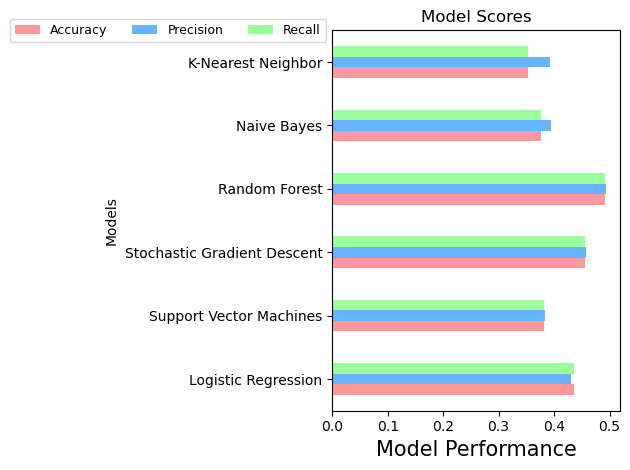

In [69]:
#Plotting the accuracy, precision and recall scores of the baseline mod
color = ['#ff9999','#66b3ff','#99ff99','#ffcc99']
ax = df_model.plot.barh(title = 'Model Scores', color = color)
ax.legend(
ncol=len(models.keys()),
bbox_to_anchor=(0, 1),
loc='right',
prop={'size': 9},
)
ax.set_xlabel('Model Performance', fontsize=15)
ax.set_ylabel('Models', fontsize='medium')
plt.tight_layout()


ROC or Receiver Operating Characteristic curve is used to evaluate logistic regression classification models.

## Modeling - Unsupervised

Although unsupervised methods might be best suited to datasets containing more data and less labels, they can still aid in discovering more patterns and aspects of the data. The elbow method depicted below indicates that there are 9 clusters in our data

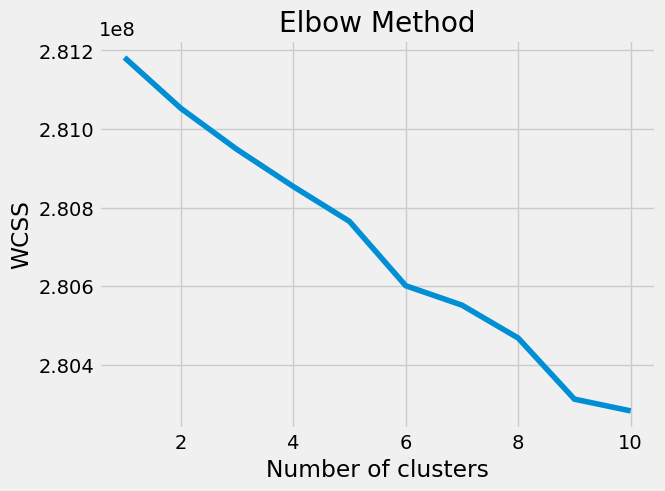

In [84]:
from sklearn.cluster import KMeans
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(X_train_ss)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [85]:
# Building the model with 3 clusters
kmode = KMeans(n_clusters=9, init = "random", n_init = 5, verbose=1)
clusters = kmode.fit_predict(X_train_ss)
clusters

Initialization complete
Iteration 0, inertia 294828617.02555406.
Iteration 1, inertia 280704515.9343376.
Iteration 2, inertia 280674215.4579169.
Converged at iteration 2: strict convergence.
Initialization complete
Iteration 0, inertia 295384530.27024746.
Iteration 1, inertia 280819527.66097677.
Iteration 2, inertia 280805178.1340372.
Iteration 3, inertia 280802512.3208933.
Converged at iteration 3: strict convergence.
Initialization complete
Iteration 0, inertia 281486318.1679808.
Iteration 1, inertia 280508066.96412706.
Iteration 2, inertia 280485918.71594805.
Iteration 3, inertia 280474707.4614326.
Iteration 4, inertia 280471723.02082753.
Iteration 5, inertia 280468570.3044804.
Iteration 6, inertia 280466778.19318134.
Iteration 7, inertia 280464742.06020653.
Converged at iteration 7: strict convergence.
Initialization complete
Iteration 0, inertia 287596027.2112973.
Iteration 1, inertia 280884935.22486514.
Iteration 2, inertia 280857315.972996.
Iteration 3, inertia 280848390.9407316

array([2, 2, 2, ..., 2, 2, 2], dtype=int32)

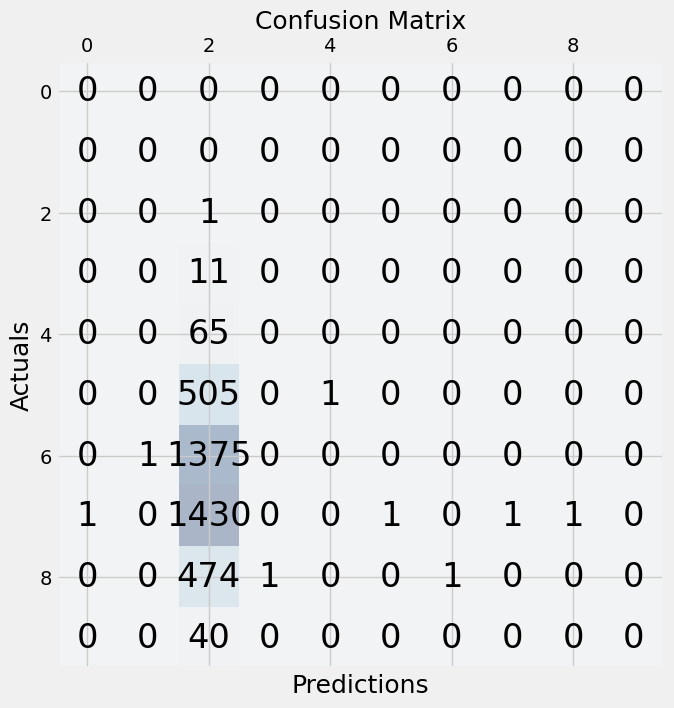

In [119]:

anime_kmeans = kmeans.fit(X_test_ss)
anime_kmeans.labels_

conf_matrix=confusion_matrix(y_test, anime_kmeans.labels_) 

fig, ax = plt.subplots(figsize=(7.5, 7.5))
ax.matshow(conf_matrix, cmap=plt.cm.Blues, alpha=0.3)
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', 
                ha='center', size='xx-large')
plt.xlabel('Predictions', fontsize=18)
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.show()

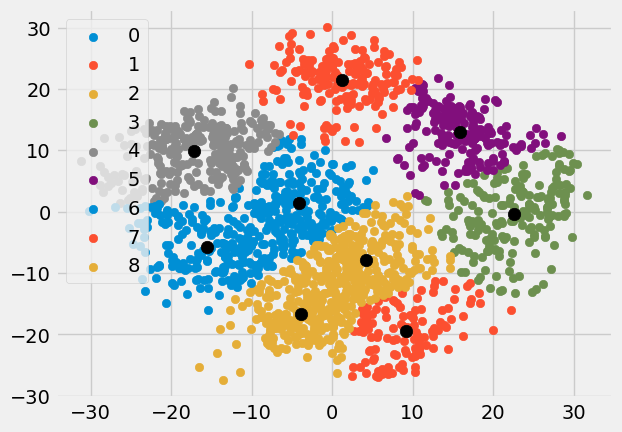

In [138]:
#Getting the Centroids
#Load Data
data = load_digits().data
pca = PCA(2)
 
#Transform the data
df = pca.fit_transform(data)
 
#Import KMeans module

 
#Initialize the class object
kmeans = KMeans(n_clusters= 9)
 
#predict the labels of clusters.
label = kmeans.fit_predict(df)
 
#Getting unique labels

centroids = kmeans.cluster_centers_
u_labels = np.unique(label)
 
#plotting the results:
 
for i in u_labels:
    plt.scatter(df[label == i , 0] , df[label == i , 1] , label = i)
plt.scatter(centroids[:,0] , centroids[:,1] , s = 80, color = 'k')
plt.legend()
plt.show()

In [129]:
#Initialize the class object
kmeans = KMeans(n_clusters= 8)
 
#predict the labels of clusters.
label = kmeans.fit_predict(df)
 
print(label)

[0 4 0 ... 4 5 5]


## Hypertuned Models

In [ ]:
#gridsearch for best parameters in Random Forest
rf = RandomForestClassifier()   
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
max_features = ['auto', 'sqrt']
min_samples_leaf = [1, 2, 4]
bootstrap = [True, False]
min_samples_split = [2, 5, 10]
random_grid = {'n_estimators': n_estimators,
               'max_features': 'sqrt',
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}


rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = -1)
grid_result_rf = rf_random.fit(X_train_ss, y_train)
# summarize results
print("Best: %f using %s" % (grid_result_rf.best_score_, grid_result_rf.best_params_))

rf_best = grid_result_rf.best_params_
# clf_best.fit(X_res, y_res)
# y_pred_clf = clf_best.predict(X_test_ss.toarray())
# y_pred_clf_train = clf_best.predict(X_res)

y_pred_rf = grid_result_rf.predict(X_test_ss.toarray())
y_pred_rn_train = grid_result_rf.predict(X_train_ss)


print('recall %s' % recall_score(y_pred_rf, y_test,  average = 'weighted')
print(classification_report(y_test, y_pred_rf))
print('Training set recall: ', metrics.recall_score(y_res, y_pred_rn_train,  average = 'weighted')
print('Test set recall: ',metrics.recall_score(y_test, y_pred_rf,  average = 'weighted')
#classification report of the improved knn model
print(classification_report(y_test, y_pred_rf))
print(confusion_matrix(y_test, y_pred_rf))

# print(np.mean(y_pred_rf == y_test))
# print(np.mean(y_pred_rf != y_test))

#looking at the number of false positives in the data 
tn, fp, fn, tp = confusion_matrix(y_test, y_pred_rf).ravel()
print('True negatives: ', tn, '\nFalse positives: ', fp, '\nFalse negatives: ', fn, '\nTrue Positives: ', tp)

AttributeError: 'numpy.ndarray' object has no attribute 'labels_'

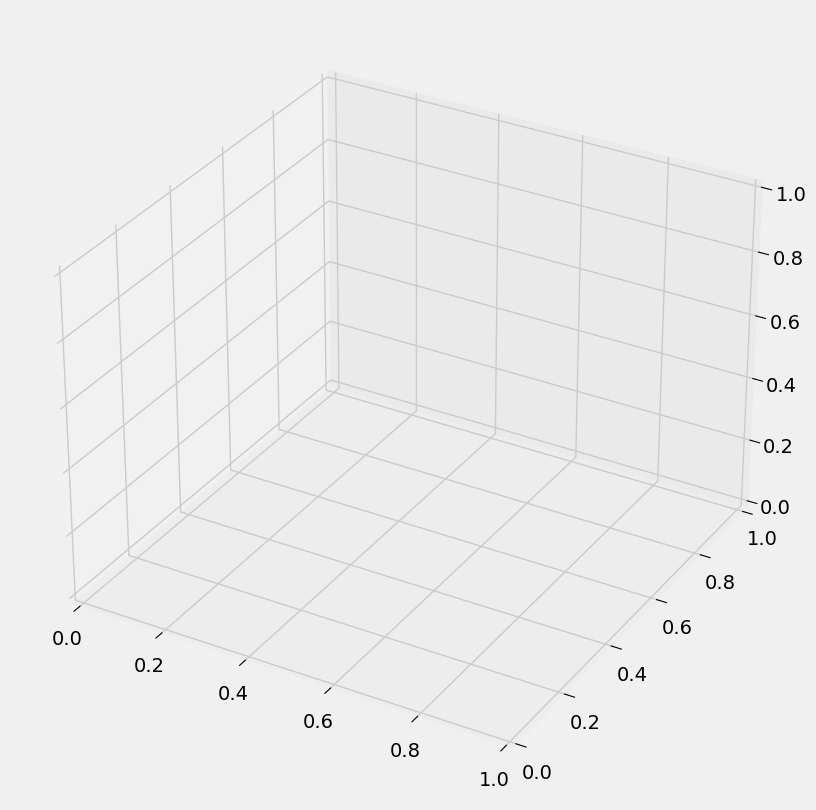

In [124]:
# names = anime.feature_names

fig = plt.figure(figsize=(20, 10))
ax1 = fig.add_subplot(1, 2, 1, projection='3d')
ax1.scatter(X_train_ss[:, 3], X_train_ss[:, 0], X_train_ss[:, 2], 
            c=X_train_ss.labels_.astype(float), 
           edgecolor="k", s=150, cmap='CMRmap')
ax1.view_init(20, -50)
# ax1.set_xlabel(names[3], fontsize=12)
# ax1.set_ylabel(names[0], fontsize=12)
# ax1.set_zlabel(names[2], fontsize=12)
ax1.set_title("K-Means Clusters for the Anime Dataset", fontsize=12)

ax2 = fig.add_subplot(1, 2, 2, projection='3d')

for label, name in enumerate(['virginica','setosa','versicolor']):
    ax2.text3D(
        X_train_ss[y_train == label, 3].mean(),
        X_train_ss[y_train == label, 0].mean(),
        X_train_ss[y_train == label, 2].mean() + 2,
        
        horizontalalignment="center",
        bbox=dict(alpha=0.2, edgecolor="w", facecolor="w"),
    )

ax2.scatter(X_train_ss[:, 3], X_train_ss[:, 0], X_train_ss[:, 2], 
            c=y_train, edgecolor="k", s=150, 
            cmap='CMRmap')
ax2.view_init(20, -50)
# ax2.set_xlabel(names[3], fontsize=12)
# ax2.set_ylabel(names[0], fontsize=12)
# ax2.set_zlabel(names[2], fontsize=12)
ax2.set_title("Actual Labels for the Iris Dataset", fontsize=12)
fig.show()

In [ ]:
# confusion matrix heatmap for the Random Forest model

group_names = ['True Pos', 'False Pos', 'False Neg', 'True Neg']
test_cnf_matrix = confusion_matrix(y_test,y_pred_rf)
test_counts = ["{0:0.0f}".format(value) for value in test_cnf_matrix.flatten()]
test_percentage = ["{0:.2%}".format(value) for value in test_cnf_matrix .flatten()/np.sum(test_cnf_matrix)]
test_labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,test_counts,test_percentage)]
test_labels = np.asarray(test_labels).reshape(2,2)
plt.figure(figsize = (16,5))
sns.heatmap(test_cnf_matrix, annot=test_labels, fmt='', cmap="YlGn").set_title('Test Data');

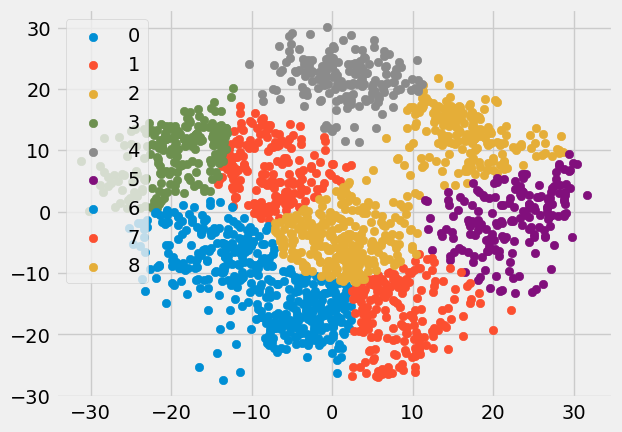

In [136]:
#Importing required modules
 
from sklearn.datasets import load_digits
from sklearn.decomposition import PCA

 
#Load Data
data = load_digits().data
pca = PCA(2)
 
#Transform the data
df = pca.fit_transform(data)
 
#Import KMeans module

 
#Initialize the class object
kmeans = KMeans(n_clusters= 9)
 
#predict the labels of clusters.
label = kmeans.fit_predict(df)
 
#Getting unique labels
u_labels = np.unique(label)
 
#plotting the results:
for i in u_labels:
    plt.scatter(df[label == i , 0] , df[label == i , 1] , label = i)
plt.legend()
plt.show()

In [ ]:
# predict probabilities ROC on hypertuned Random Forest model
calibrator = CalibratedClassifierCV(rf_random, cv='prefit')
model_rf=calibrator.fit(X_train_ss, y_train)
yhat_rf = rf_random.predict_proba(X_test_ss)
# retrieve just the probabilities for the positive class
pos_probs = yhat_rf[:, 1]
# plot no skill roc curve
plt.plot([0, 1], [0, 1], linestyle='--', label='No Skill')
# calculate roc curve for model
fpr, tpr, _ = roc_curve(y_test, pos_probs, average = 'weighted')
# plot model roc curve
plt.plot(fpr, tpr, marker='.', label='RF')
# axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# show the legend
plt.legend()
# show the plot
plt.show()

Hypertuning our second model: Logistic Regression

In [ ]:
#Hypertuning a Logistic Regression model
clf_reg = LogisticRegression()
param_grid_lr = ({"max_iter": [20, 50, 100, 200, 500, 1000],
                  "solver": ["newton-cg", "lbfgs", "liblinear", "sag", "saga"],
                  "class_weight": ["balanced"],
                  "penalty" : 'none',
                  'C' : [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000]})


logModel_grid = RandomizedSearchCV(estimator=clf_reg, scoring ="recall", param_distributions =param_grid_lr, verbose=1, cv=3, n_jobs=-1)

# print(logModel_grid.best_estimator_)
logModel_grid.fit(X_train_ss, y_train)
print(logModel_grid.best_param_)
y_pred_lr = logModel_grid.predict(X_test_ss)
y_pred_lr_train = logModel_grid.predict(X_train_ss)

      

print('recall %s' % recall_score(y_pred_lr, y_test, average = 'weighted'))
print(classification_report(y_test, y_pred_lr))
print('Training set recall: ', metrics.recall_score(y_train, y_pred_lr_train, average='weighted'))
print('Test set recall: ',metrics.recall_score(y_test, y_pred_lr, average='weighted'))
#classification report of the improved knn model
print(classification_report(y_test, y_pred_lr))
print(confusion_matrix(y_test, y_pred_lr))

# print(np.mean(y_pred_clf == y_test))
# print(np.mean(y_pred_clf != y_test))

#looking at the number of false positives in the data 
tn, fp, fn, tp = confusion_matrix(y_test, y_pred_lr).ravel()
print('True negatives: ', tn, '\nFalse positives: ', fp, '\nFalse negatives: ', fn, '\nTrue Positives: ', tp)

In [ ]:
# confusion matrix heatmap for hypertuned Logistic Rregression model
group_names = ['True Pos', 'False Pos', 'False Neg', 'True Neg']
test_cnf_matrix = confusion_matrix(y_test,y_pred_lr)
test_counts = ["{0:0.0f}".format(value) for value in test_cnf_matrix.flatten()]
test_percentage = ["{0:.2%}".format(value) for value in test_cnf_matrix .flatten()/np.sum(test_cnf_matrix)]
test_labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,test_counts,test_percentage)]
test_labels = np.asarray(test_labels).reshape(2,2)
plt.figure(figsize = (16,5))
sns.heatmap(test_cnf_matrix, annot=test_labels, fmt='', cmap="YlGn").set_title('Test Data');

In [ ]:
# predict probabilities ROC on hypertuned logistic Regression model
calibrator = CalibratedClassifierCV(logModel_grid, cv='prefit')
model_lr=calibrator.fit(X_res, y_res)
yhat_lr = logModel_grid.predict_proba(X_test_ss)
# retrieve just the probabilities for the positive class
pos_probs = yhat_lr[:, 1]  
# plot no skill roc curve
plt.plot([0, 1], [0, 1], linestyle='--', label='No Skill')
# calculate roc curve for model
fpr, tpr, _ = roc_curve(y_test, pos_probs, pos_label='Positive emotion')
# plot model roc curve
plt.plot(fpr, tpr, marker='.', label='Hypertuned Logistic Regression')
# axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# show the legend
plt.legend()
# show the plot
plt.show()


Hypertuning with pipeline for MultinomialNB model

In [ ]:
pipeline = Pipeline([('vect', CountVectorizer()),
               ('tfidf', TfidfTransformer()),
               ('ss', StandardScaler(with_mean=False)),
               ('clf', MultinomialNB()),
              ])

parameters = {
    'vect__max_df': (0.5, 0.75, 1.0),
    'tfidf__use_idf': (True, False),
    'reg__alpha': (0.00001, 0.000001),
}

grid_search = RandomizedSearchCV(pipeline, parameters)

grid_search.fit(X_train, y_train)


y_pred = nb.predict(list(X_test))

print('accuracy %s' % accuracy_score(y_pred, y_test))
print('precision %s' % precision_score(y_pred, y_test, average='weighted'))
print('recall %s' % recall_score(y_pred, y_test, average='weighted'))
print(classification_report(y_test, y_pred))

Hypertuning with Stochastic Gradient Descent

In [127]:
sgd = SGDClassifier(loss='hinge',class_weight='balanced')
clf =sgd.fit(X_train_ss, y_train)
calibrator = CalibratedClassifierCV(clf, cv='prefit')
sgd_model=calibrator.fit(X_train_ss, y_train)

y_train_pred = sgd_model.predict_proba(X_train_ss)
y_test_pred = sgd_model.predict_proba(X_test_ss)

print('recall %s' % recall_score(y_pred_clf, y_test, average='weighted'))
print(classification_report(y_test, y_pred_clf))
print('Training set recall: ', metrics.recall_score(y_res, y_pred_clf_train, average= 'weighted'))
print('Test set recall: ',metrics.recall_score(y_test, y_pred_clf, average= 'weighted'))
#classification report of the improved knn model
print(classification_report(y_test, y_pred_clf))
print(confusion_matrix(y_test, y_pred_clf))

# print(np.mean(y_pred_clf == y_test))
# print(np.mean(y_pred_clf != y_test))

#looking at the number of false positives in the data 
tn, fp, fn, tp = confusion_matrix(y_test, y_pred_clf).ravel()
print('True negatives: ', tn, '\nFalse positives: ', fp, '\nFalse negatives: ', fn, '\nTrue Positives: ', tp)

NameError: name 'y_pred_clf' is not defined

In [97]:
#Stochastic Gradient Descent hypertuning model 

model_sgd = SGDClassifier(max_iter=500)
params = {
    "loss" : ["hinge", "log", "squared_hinge", "modified_huber"],
    "alpha" : [0.0001, 0.001, 0.01, 0.1],
    "penalty" : ["l2", "l1", "none"]
}


clf = GridSearchCV(model_sgd, param_grid=params)



clf.fit(X_train_ss, y_train)
print("Best: %f using %s" % (clf.best_score_, clf.best_params_))
clf_best = clf.best_params_
# clf_best.fit(X_res, y_res)  
# y_pred_clf = clf_best.predict(X_test_ss.toarray())
# y_pred_clf_train = clf_best.predict(X_res)

y_pred_clf = clf.predict(X_test_ss)
y_pred_clf_train = clf.predict(X_train_ss)


print('recall %s' % recall_score(y_pred_clf, y_test, average='weighted'))
print(classification_report(y_test, y_pred_clf))
print('Training set recall: ', metrics.recall_score(y_res, y_pred_clf_train, average= 'weighted'))
print('Test set recall: ',metrics.recall_score(y_test, y_pred_clf, average= 'weighted'))
#classification report of the improved knn model
print(classification_report(y_test, y_pred_clf))
print(confusion_matrix(y_test, y_pred_clf))

print(np.mean(y_pred_clf == y_test))
print(np.mean(y_pred_clf != y_test))

#looking at the number of false positives in the data 
tn, fp, fn, tp = confusion_matrix(y_test, y_pred_clf).ravel()
print('True negatives: ', tn, '\nFalse positives: ', fp, '\nFalse negatives: ', fn, '\nTrue Positives: ', tp)

TypeError: BaseSearchCV.fit() takes 2 positional arguments but 3 were given

In [ ]:
# confusion matrix 
group_names = ['True Pos', 'False Pos', 'False Neg', 'True Neg']
test_cnf_matrix = confusion_matrix(y_test,y_pred_clf)
test_counts = ["{0:0.0f}".format(value) for value in test_cnf_matrix.flatten()]
test_percentage = ["{0:.2%}".format(value) for value in test_cnf_matrix .flatten()/np.sum(test_cnf_matrix)]
test_labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,test_counts,test_percentage)]
test_labels = np.asarray(test_labels).reshape(2,2)
plt.figure(figsize = (16,5))
sns.heatmap(test_cnf_matrix, annot=test_labels, fmt='', cmap="YlGn").set_title('Test Data');

In [ ]:
# plot the 7 most important features
plt.figure(figsize=(10,7))
feat_importances = pd.Series(clf.feature_importances_, index = X_train_ss.columns)
feat_importances.nlargest(7).plot(kind='barh');

## Comparing the hypertuned models

In [ ]:
#Comparing the hypertuned models by putting them in a dictionary
models_tuned = {}

# Stochastic Gradient Descent
models_tuned['Stochastic Gradient Descent'] = SGDClassifier(alpha= 0.01, loss = 'log', penalty= 'l2')


# Logistic Regression
models_tuned['Logistic Regression'] = LogisticRegression(C=0.0001, class_weight='balanced', max_iter=20, penalty='none', solver='newton-cg')


#Random Forest
models_tuned['Random Forest'] = RandomForestClassifier(n_estimators= 1400, min_samples_split= 5, min_samples_leaf= 2, max_features= 'sqrt', max_depth= None, bootsrap = False)
                                                      

In [ ]:
#create table and image of table comparing the accuracy between the hypertuned models
df_model_tuned = pd.DataFrame(index=models_tuned.keys(), columns=['Recall'])
df_model_tuned['Recall'] = recall.values()

columns=['Recall']


hypertuned_models_recall = (tabulate(df_model_tuned, headers = columns, tablefmt="grid"))
print(hypertuned_models_recall)

In [ ]:
#Plotting the recall scores of the hypertuned models
colors = ['#ff9999','#66b3ff','#99ff99','#ffcc99']
ax = df_model_tuned.plot.barh(color = colors)
ax.set_title('Hypertuned Model Comparison')
ax.set_xlabel('Recall')
ax.set_ylabel('Models')
ax.legend(
    ncol=len(models_tuned.keys()), 
    
)
plt.tight_layout()

## Word2Vec Model

Word embeddings is a technique where individual words are transformed into a numerical representation of the word (a vector). Where each word is mapped to one vector, this vector is then learned in a way which resembles a neural network. 

In [ ]:
from gensim.models import Word2Vec as w2v

w = w2v(
    X_train_ss,
    min_count=3,  
    sg = 1,       
    window=7      
)       

print(w.wv.most_similar('action'))

emb_df = (
    pd.DataFrame(
        [w.wv.get_vector(str(n)) for n in w.wv.key_to_index],
        index = w.wv.key_to_index
    )
)
print(emb_df.shape)
emb_df.head()

In [ ]:


w2v = word2vec(X_train_ss, min_count=5, size = 5)

print(w2v)

print(w2v['action'])
#list the vocabulary words
words = list(w2v.wv.vocab)

print(words)

In [ ]:
w2v.wv.vocab

X = w2v[w2v.wv.vocab]
pca = PCA(n_components=2)

result = pca.fit_transform(X)

# create a scatter plot of the projection
plt.scatter(result[:, 0], result[:, 1])
words = list(w2v.wv.vocab)

for i, word in enumerate(words):
   plt.annotate(word, xy=(result[i, 0], result[i, 1]))

plt.show()


In [ ]:
X = model[model.wv.vocab]
pca = PCA(n_components=2)
result = pca.fit_transform(X)

#create df from the pca results
pca_df = pd.DataFrame(result, columns = ['x','y'])

#add the words for the hover effect
pca_df['word'] = words
pca_df.head()

N = 1000000
words = list(model.wv.vocab)
fig = go.Figure(data=go.Scattergl(
   x = pca_df['x'],
   y = pca_df['y'],
   mode='markers',
   marker=dict(
       color=np.random.randn(N),
       colorscale='Viridis',
       line_width=1
   ),
   text=pca_df['word'],
   textposition="bottom center"
))

fig.show()

In [ ]:
#explore embeddings using cosine similarity
model.wv.most_similar('eric')

model.wv.most_similar_cosmul(positive = ['phone', 'number'], negative = ['call'])

model.wv.doesnt_match("phone number prison cell".split())

#save embeddings
file = 'email_embd.txt'
model.wv.save_word2vec_format(filename, binary = False)

In [67]:
model = gensim.models.Word2Vec(
        X_train_ss.all(),
        vector_size=150,
        window=10,
        min_count=2,
        workers=10)

TypeError: The corpus_iterable must be an iterable of lists of strings, got False instead

In [ ]:
def get_word2vec_model(tokenized_sentences):
    start_time = time.time()
    print("Getting word2vec model...")
    model = Word2Vec(tokenized_sentences, sg=1, window=window_size,vector_size=size, min_count=min_count, workers=workers, epochs=epochs, sample=0.01)
    log_total_time(start_time)
    return model 


def get_word2vec_model_vector(model):
    start_time = time.time()
    print("Training...")
#     model = Word2Vec(tokenized_sentences, min_count=1)
    model.build_vocab(sentences=shuffle_corpus(tokenized_sentences), update=True)
    # Training the model
    for i in tqdm(range(5)):
        model.train(sentences=shuffle_corpus(tokenized_sentences), epochs=50, total_examples=model.corpus_count)
    log_total_time(start_time)
    return model.wv

def shuffle_corpus(sentences):
    shuffled = list(sentences)
    random.shuffle(shuffled)
    return shuffled

In [ ]:
model.train(anime, total_examples=model.)

In [ ]:

print(model.wv.most_similar('action'))

emb_df = (
    pd.anime(
        [w.wv.get_vector(str(n)) for n in w.wv.key_to_index],
        index = w.wv.key_to_index
    )
)
print(emb_df.shape)
emb_df.head()

In [ ]:
w1 = 'action'
model.wv.most_similar (positive = w1)

In [ ]:
pca = PCA(n_components=2, random_state=7)
pca_mdl = pca.fit_transform(emb_df)

emb_df_PCA = (
    pd.DataFrame(
        pca_mdl,
        columns=['x','y'],
        index = emb_df.index
    )
)

plt.clf()
fig = plt.figure(figsize=(6,4))

plt.scatter(
    x = emb_df_PCA['x'],
    y = emb_df_PCA['y'],
    s = 0.4,
    color = 'maroon',
    alpha = 0.5
)

plt.xlabel('PCA-1')
plt.ylabel('PCA-2')
plt.title('PCA Visualization')
plt.plot()

## Recommendation System

A recommendation system using the library Surprise is able to recommend the most similar item to the one inputted. MyAnimeList was created in order to keep a list, talk to other fans, but also to find your next favorite anime! In order to do so, one can 

In [61]:


tfv = TfidfVectorizer(min_df=3, max_features=None, strip_accents="unicode", analyzer="word",
                      token_pattern=r"\w{1,}", ngram_range=(1, 3), stop_words = "english")

rec_data = anime.copy()
rec_data.drop_duplicates(subset ="MAL_Title", keep = "first", inplace = True)
rec_data.reset_index(drop = True, inplace = True)
genres = rec_data["MAL_Genres"].str.split(", | , | ,").astype(str)
tfv_matrix = tfv.fit_transform(genres)

In [62]:
from sklearn.metrics.pairwise import sigmoid_kernel

sig = sigmoid_kernel(tfv_matrix, tfv_matrix)      # Computing sigmoid kernel

rec_indices = pd.Series(rec_data.index, index = rec_data["MAL_Title"]).drop_duplicates()


# Recommendation Function
def give_recommendation(title, sig = sig):
    
    idx = rec_indices[title] # Getting index corresponding to original_title

    sig_score = list(enumerate(sig[idx]))  # Getting pairwsie similarity scores 
    sig_score = sorted(sig_score, key=lambda x: x[1], reverse=True)
    sig_score = sig_score[1:11]
    anime_indices = [i[0] for i in sig_score]
     
    # Top 10 most similar movies
    rec_dic = {"No" : range(1,11), 
               "Anime Name" : anime["MAL_Title"].iloc[anime_indices].values,
               "Rating" : anime["MAL_Score"].iloc[anime_indices].values}
    dataframe = pd.DataFrame(data = rec_dic)
    dataframe.set_index("No", inplace = True)
    
    print(f"Recommendations for {title} viewers :\n")
    
    return dataframe.style.set_properties(**{"background-color": "#2a9d8f","color":"white","border": "1.5px  solid black"})

In [63]:
give_recommendation("Death Note")

Recommendations for Death Note viewers :



,Anime Name,Rating
No,,
1,Munou na Nana,7.191000
2,Death Note: Rewrite,7.701000
3,Warau Salesman Special Program,6.161000
4,Zhongguo Jingqi Xiansheng,6.071000
5,Mahou Shoujo Ikusei Keikaku,6.961000
6,Higurashi no Naku Koro ni Kai,8.191000
7,Summertime Render,8.491000
8,Higurashi no Naku Koro ni Rei,7.411000
9,Mouryou no Hako,7.151000


In [64]:
give_recommendation("Mahou no Tenshi Creamy Mami")

Recommendations for Mahou no Tenshi Creamy Mami viewers :



,Anime Name,Rating
No,,
1,Tokyo Mew Mew New â¡,6.641000
2,Mahou no Tenshi Creamy Mami,7.231000
3,Mahoutsukai Tai!,7.041000
4,Chu Feng: B.E.E,5.861000
5,Cosmic Fantasy: Ginga Mehyou no Wana,5.291000
6,Mahou no Tenshi Creamy Mami: Zutto Kitto Motto,5.831000
7,Masou Gakuen HxH,6.141000
8,Kotetsu no Daibouken,5.771000
9,Tenkuu no Shiro Laputa,8.261000


In [65]:
give_recommendation("Fruits Basket")

Recommendations for Fruits Basket viewers :



,Anime Name,Rating
No,,
1,Fruits Basket 1st Season,8.221000
2,Akagami no Shirayuki-hime,7.761000
3,Nagi no Asu kara,7.991000
4,Fruits Basket,7.681000
5,Akagami no Shirayuki-hime 2nd Season,7.981000
6,Romeo x Juliet,7.601000
7,"Akagami no Shirayuki-hime: Nandemonai Takaramono, Kono Page",7.711000
8,Shinkyoku Soukai Polyphonica,6.811000
9,Shinkyoku Soukai Polyphonica Crimson S,7.151000


## Word Cloud

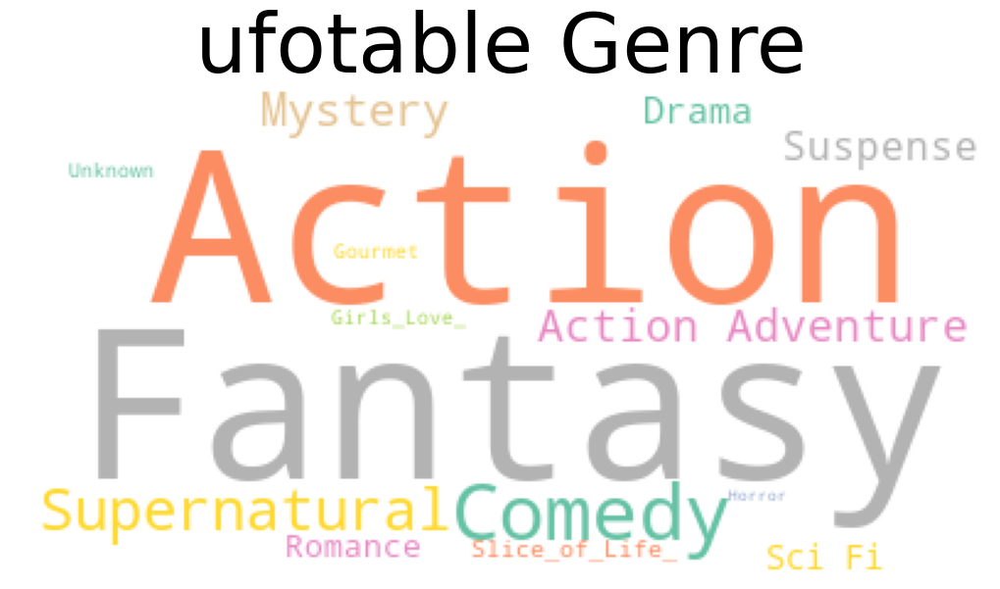

In [98]:
u_genre = ""
myanimelist.MAL_Genres[myanimelist.Studios == "ufotable"].unique()

for i in list(myanimelist.MAL_Genres[myanimelist.Studios == "ufotable"]) :
    j = [k.strip() for k in i.split(",")]
    for a in j :
        if len(a.split()) > 1 :
            s = ""
            for b in a.split() :
                s += b + "_"
            u_genre += s + " "
        else :
            u_genre += a + " "
wc = WordCloud(background_color ='white', colormap = "Set2").generate(u_genre)
plt.figure(figsize = (10, 10), facecolor = None)
plt.imshow(wc)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("ufotable Genre", fontsize=60)
plt.show()


let's explore how genre's wordcloud looks like



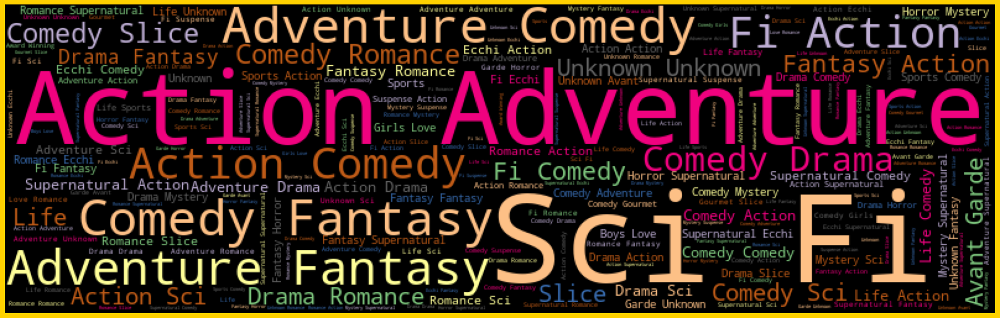

In [99]:
wordcloud = WordCloud(width = 800, height = 250, background_color ="black", colormap = 'Accent',
max_font_size=100, stopwords =None,repeat= True).generate(myanimelist["MAL_Genres"].str.cat(sep= ", | , | , "))
print("let's explore how genre's wordcloud looks like\n")
plt.figure(figsize = (20, 8),facecolor = "#ffd100")
plt.imshow(wordcloud)
plt.axis("off")
plt.margins(x = 0, y = 0)
plt.tight_layout(pad = 0)
plt.show()
